In [ ]:
!pip install datasets --quiet

import torch
import torchvision
print(f"Torch version: {torch.__version__}")
print(f"CUDA available: {torch.cuda.is_available()}")

!pip install huggingface_hub --quiet

from huggingface_hub import notebook_login
notebook_login()


Torch version: 2.6.0+cu124
CUDA available: True


/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


README.md:   0%|          | 0.00/418 [00:00<?, ?B/s]

(…)-00000-of-00003-78c50153d52a30d7.parquet:   0%|          | 0.00/450M [00:00<?, ?B/s]

(…)-00001-of-00003-f71c094e5355c8fc.parquet:   0%|          | 0.00/453M [00:00<?, ?B/s]

(…)-00002-of-00003-c0e07c6b6c71e71b.parquet:   0%|          | 0.00/451M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/7233 [00:00<?, ? examples/s]

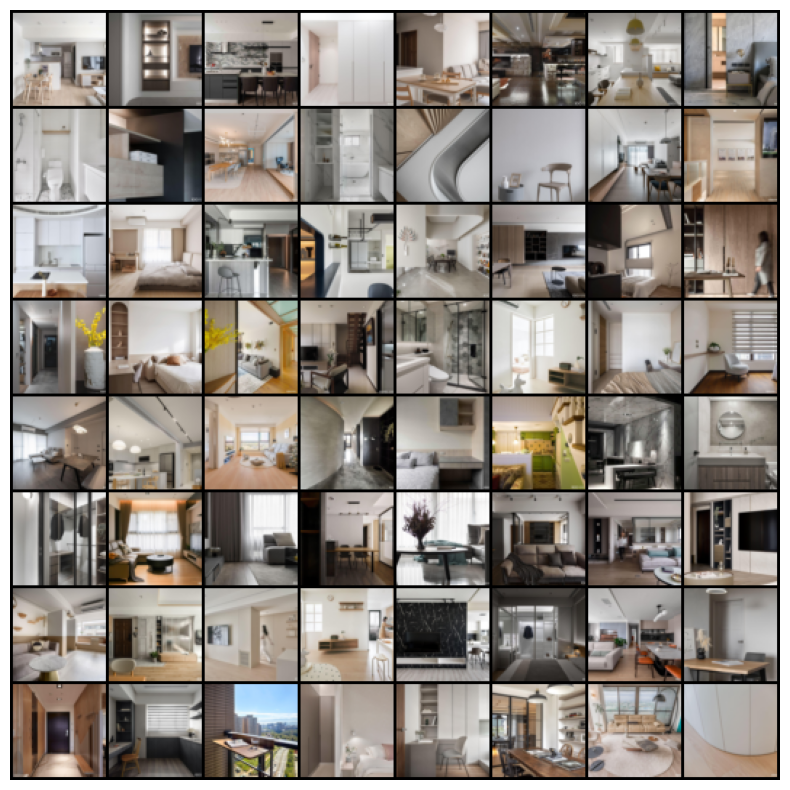

In [ ]:
from datasets import load_dataset
from torchvision import transforms
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder
from torchvision.utils import make_grid
import matplotlib.pyplot as plt
import torch
import os

dataset = load_dataset("hammer888/interior_style_dataset", split="train")
os.makedirs("interior_images/all", exist_ok=True)

for idx, example in enumerate(dataset):
    img = example['image']
    img.save(f"interior_images/all/{idx}.jpg")

transform = transforms.Compose([
    transforms.Resize(64),
    transforms.CenterCrop(64),
    transforms.ToTensor(),
    transforms.Normalize([0.5]*3, [0.5]*3)
])
dataset = ImageFolder(root="interior_images", transform=transform)
batch_size = 128
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=2, pin_memory=True)
def show_batch(dl):
    for images, _ in dl:
        grid = make_grid(images[:64], nrow=8, normalize=True)
        plt.figure(figsize=(10,10))
        plt.imshow(grid.permute(1, 2, 0))
        plt.axis('off')
        break

show_batch(dataloader)

In [ ]:
print(dataset)


Dataset ImageFolder
    Number of datapoints: 7233
    Root location: interior_images
    StandardTransform
Transform: Compose(
               Resize(size=64, interpolation=bilinear, max_size=None, antialias=True)
               CenterCrop(size=(64, 64))
               ToTensor()
               Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
           )


In [ ]:
import torch.nn as nn
torch.manual_seed(42)
class Generator(nn.Module):
    def __init__(self, latent_dim, feature_maps_g, channels_img):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            nn.ConvTranspose2d(latent_dim, feature_maps_g * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(feature_maps_g * 8),
            nn.ReLU(True),

            nn.ConvTranspose2d(feature_maps_g * 8, feature_maps_g * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(feature_maps_g * 4),
            nn.ReLU(True),

            nn.ConvTranspose2d(feature_maps_g * 4, feature_maps_g * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(feature_maps_g * 2),
            nn.ReLU(True),

            nn.ConvTranspose2d(feature_maps_g * 2, feature_maps_g, 4, 2, 1, bias=False),
            nn.BatchNorm2d(feature_maps_g),
            nn.ReLU(True),

            nn.ConvTranspose2d(feature_maps_g, channels_img, 4, 2, 1, bias=False),
            nn.Tanh()  # Output between [-1, 1]
        )

    def forward(self, x):
        return self.main(x)

class Discriminator(nn.Module):
    def __init__(self, channels_img, feature_maps_d):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            nn.Conv2d(channels_img, feature_maps_d, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(feature_maps_d, feature_maps_d * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(feature_maps_d * 2),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(feature_maps_d * 2, feature_maps_d * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(feature_maps_d * 4),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(feature_maps_d * 4, feature_maps_d * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(feature_maps_d * 8),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(feature_maps_d * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.main(x)

device = "cuda" if torch.cuda.is_available() else "cpu"

latent_dim = 100
feature_maps_g = 64
feature_maps_d = 64
channels_img = 3

gen = Generator(latent_dim, feature_maps_g, channels_img).to(device)
disc = Discriminator(channels_img, feature_maps_d).to(device)

print(f"Generator Architecture:\n{gen}\n")
print(f"Discriminator Architecture:\n{disc}")

Generator Architecture:
Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)

Using device: cuda


Epoch 1/100: 100%|██████████| 57/57 [01:05<00:00,  1.15s/it, D_loss=1.0878, G_loss=4.6962]


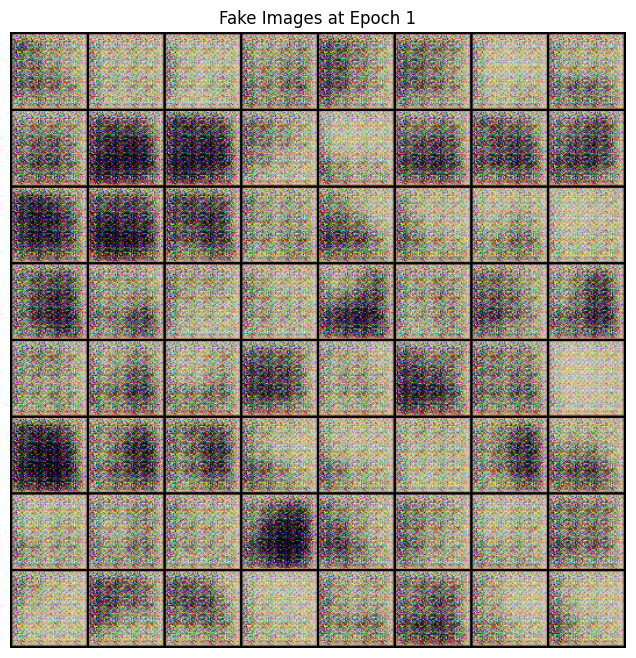

Epoch 10/100: 100%|██████████| 57/57 [01:04<00:00,  1.13s/it, D_loss=0.2577, G_loss=3.9446]


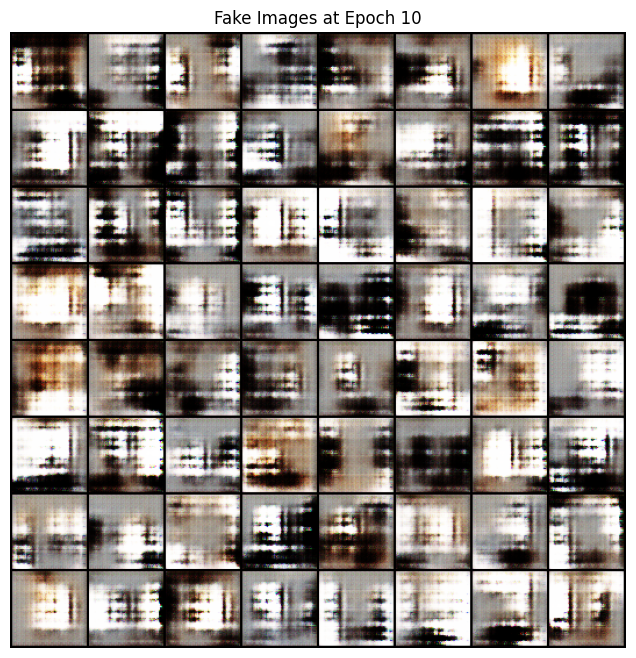

Epoch 20/100: 100%|██████████| 57/57 [01:04<00:00,  1.13s/it, D_loss=0.1854, G_loss=4.2781]


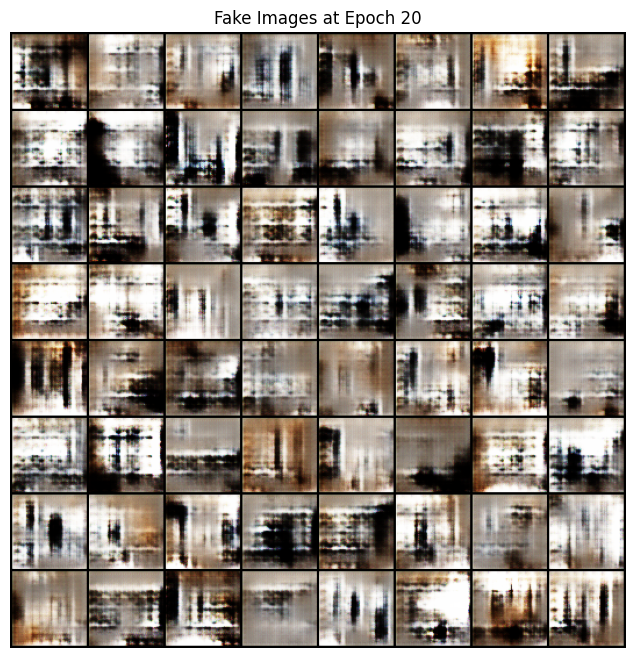

Epoch 30/100: 100%|██████████| 57/57 [01:03<00:00,  1.12s/it, D_loss=1.7051, G_loss=4.9208]


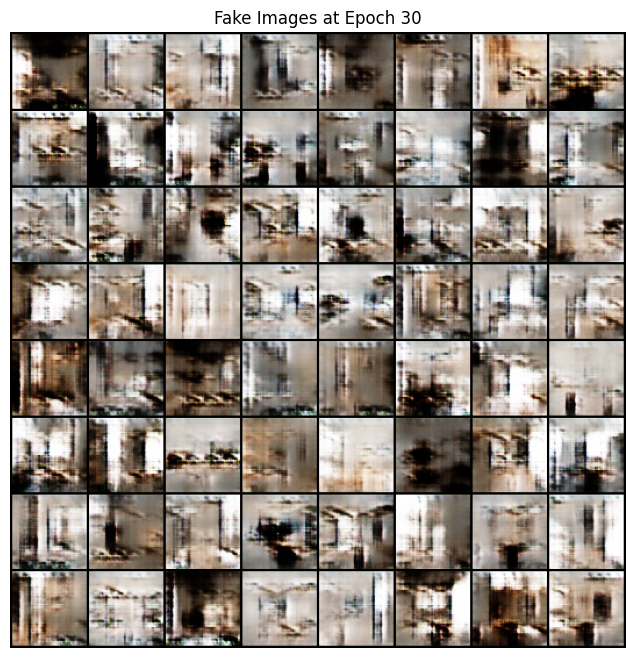

Epoch 40/100: 100%|██████████| 57/57 [01:04<00:00,  1.14s/it, D_loss=0.1568, G_loss=5.7844]


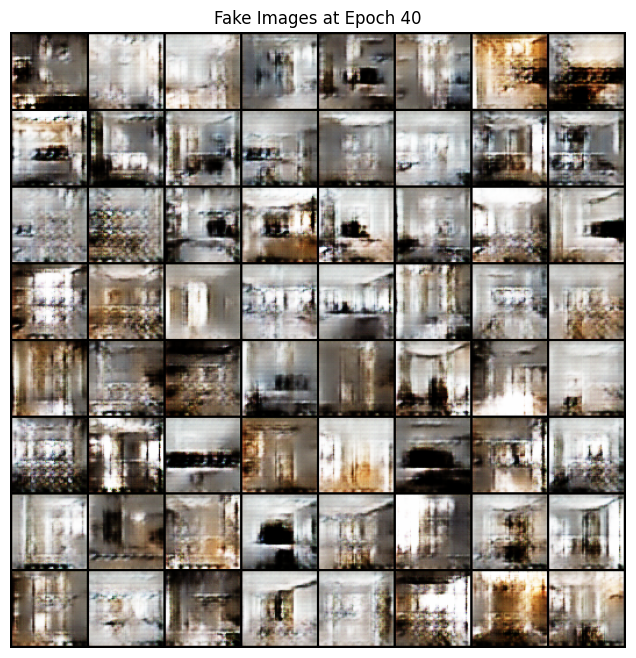

Epoch 50/100: 100%|██████████| 57/57 [01:03<00:00,  1.12s/it, D_loss=0.3643, G_loss=7.8172]


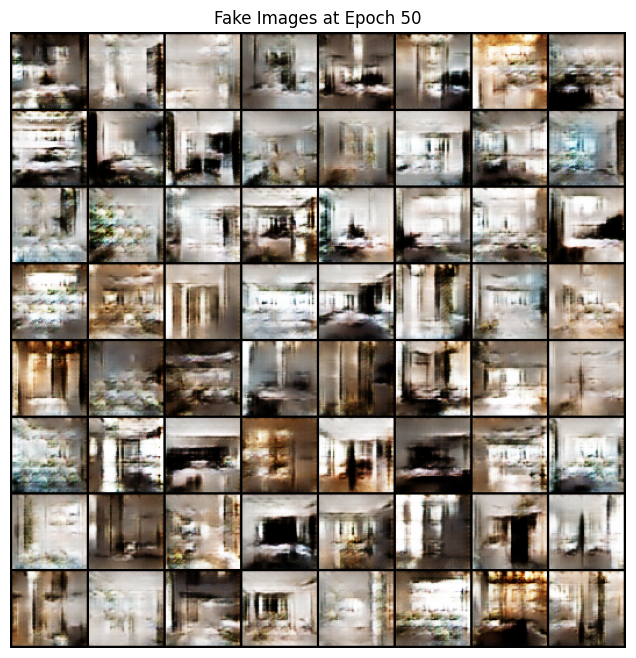

Epoch 60/100: 100%|██████████| 57/57 [01:04<00:00,  1.13s/it, D_loss=0.4008, G_loss=7.4787]


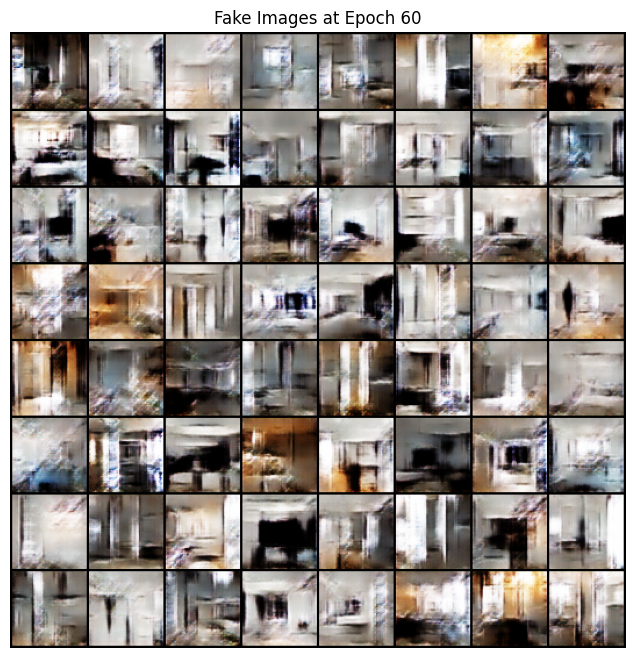

Epoch 70/100: 100%|██████████| 57/57 [01:03<00:00,  1.12s/it, D_loss=0.1427, G_loss=4.1636]


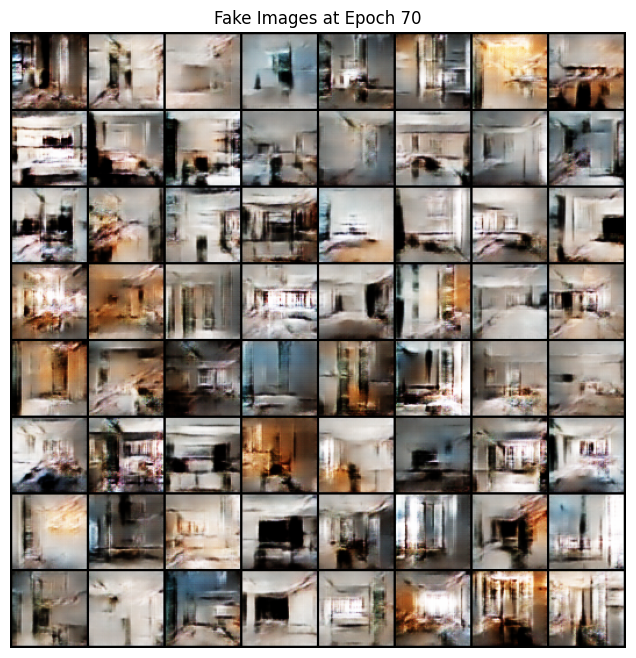

Epoch 80/100: 100%|██████████| 57/57 [01:04<00:00,  1.13s/it, D_loss=0.1256, G_loss=4.8010]


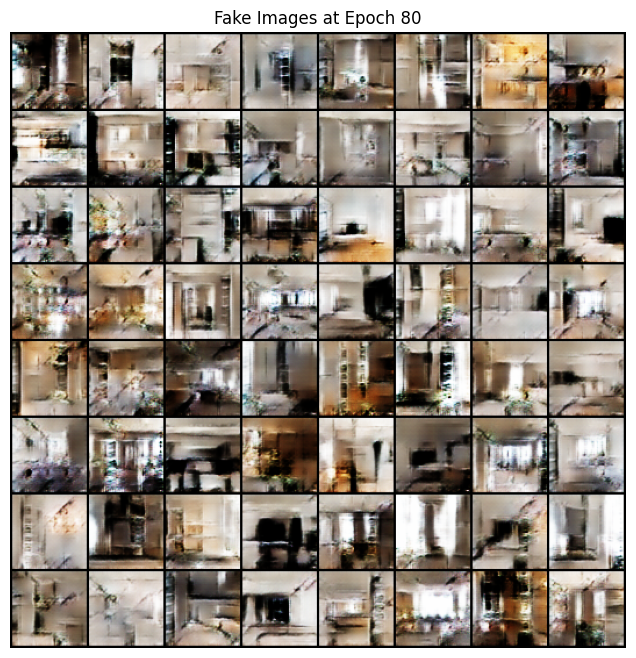

Epoch 90/100: 100%|██████████| 57/57 [01:03<00:00,  1.12s/it, D_loss=0.1185, G_loss=4.9166]


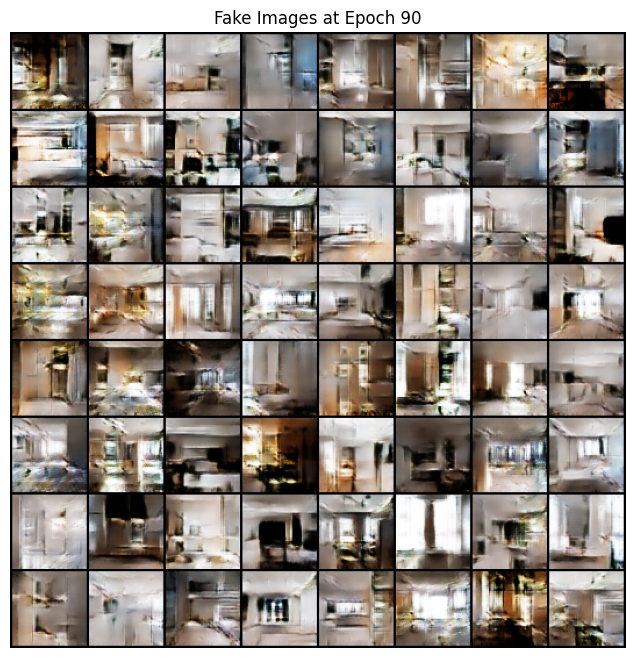

Epoch 100/100: 100%|██████████| 57/57 [01:02<00:00,  1.10s/it, D_loss=0.1324, G_loss=5.3019]


In [ ]:
import torch.nn as nn
import torch.optim as optim
from tqdm import tqdm

criterion = nn.BCELoss()
lr = 0.0002
beta1 = 0.5

optimizerD = optim.Adam(disc.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(gen.parameters(), lr=lr, betas=(beta1, 0.999))

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

gen.to(device)
disc.to(device)

fixed_noise = torch.randn(64, 100, 1, 1, device=device)

num_epochs = 100
real_label = 1.0
fake_label = 0.0

G_losses = []
D_losses = []

for epoch in range(num_epochs):
    pbar = tqdm(dataloader, desc=f"Epoch {epoch+1}/{num_epochs}")

    for i, (real_images, _) in enumerate(pbar):
        disc.zero_grad()

        real_images = real_images.to(device)
        b_size = real_images.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)

        output = disc(real_images).view(-1)
        errD_real = criterion(output, label)
        errD_real.backward()

        noise = torch.randn(b_size, 100, 1, 1, device=device)
        fake_images = gen(noise)

        label.fill_(fake_label)
        output = disc(fake_images.detach()).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward()

        optimizerD.step()

        gen.zero_grad()
        label.fill_(real_label)

        output = disc(fake_images).view(-1)
        errG = criterion(output, label)
        errG.backward()

        optimizerG.step()

        G_losses.append(errG.item())
        D_losses.append(errD_real.item() + errD_fake.item())

        pbar.set_postfix({
            "D_loss": f"{(errD_real+errD_fake).item():.4f}",
            "G_loss": f"{errG.item():.4f}"
        })
    if (epoch+1) % 10 == 0 or epoch == 0:
        with torch.no_grad():
            fake = gen(fixed_noise).detach().cpu()
        grid = make_grid(fake, nrow=8, normalize=True)
        plt.figure(figsize=(8,8))
        plt.imshow(grid.permute(1, 2, 0))
        plt.axis('off')
        plt.title(f"Fake Images at Epoch {epoch+1}")
        plt.show()

In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [ ]:
import torch
import os

save_dir = '/content/drive/MyDrive/gan_interior/'
checkpoint_path = os.path.join(save_dir, 'gan_checkpoint_epoch100.pth')

latent_dim = 100
feature_maps_g = 64
feature_maps_d = 64
channels_img = 3

gen = Generator(latent_dim, feature_maps_g, channels_img).to(device)
disc = Discriminator(channels_img, feature_maps_d).to(device)

optimizerG = torch.optim.Adam(gen.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizerD = torch.optim.Adam(disc.parameters(), lr=0.0002, betas=(0.5, 0.999))

checkpoint = torch.load(checkpoint_path, map_location=device)

gen.load_state_dict(checkpoint['generator_state_dict'])
disc.load_state_dict(checkpoint['discriminator_state_dict'])
optimizerG.load_state_dict(checkpoint['optimizerG_state_dict'])
optimizerD.load_state_dict(checkpoint['optimizerD_state_dict'])

start_epoch = checkpoint['epoch']
print(f" Models and optimizers loaded successfully! (Last trained epoch: {start_epoch})")

 Models and optimizers loaded successfully! (Last trained epoch: 100)


In [ ]:
!pip install -q torchmetrics[image] torchvision

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 124.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 95.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 59.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 41.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 17.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 109.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 961.5/961.5 kB 63.8 MB/s eta 0:00:00


Downloading: "https://github.com/toshas/torch-fidelity/releases/download/v0.2.0/weights-inception-2015-12-05-6726825d.pth" to /root/.cache/torch/hub/checkpoints/weights-inception-2015-12-05-6726825d.pth
100%|██████████| 91.2M/91.2M [00:02<00:00, 41.5MB/s]
/usr/local/lib/python3.11/dist-packages/torchmetrics/utilities/prints.py:43: UserWarning: Metric `InceptionScore` will save all extracted features in buffer. For large datasets this may lead to large memory footprint.
  warnings.warn(*args, **kwargs)
100%|██████████| 170M/170M [00:13<00:00, 12.7MB/s]


✅ FID Score: 328.3373
✅ Inception Score: 2.6778 ± 0.1779


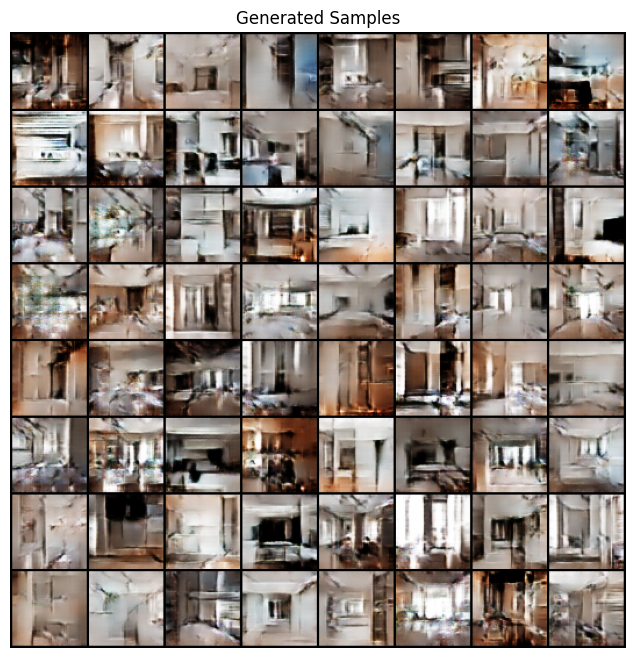

In [ ]:
import torch
from torchmetrics.image.fid import FrechetInceptionDistance
from torchmetrics.image.inception import InceptionScore
from torchvision.utils import make_grid
from torchvision import transforms
import torchvision
import numpy as np
import matplotlib.pyplot as plt

fid = FrechetInceptionDistance(feature=2048).to(device)
inception_score = InceptionScore(normalize=True).to(device)

gen.eval()
num_images = 500

fake_images = []
batch_size = 64

with torch.no_grad():
    for _ in range(num_images // batch_size):
        noise = torch.randn(batch_size, latent_dim, 1, 1, device=device)
        fake_batch = gen(noise)
        fake_images.append(fake_batch)

fake_images = torch.cat(fake_images, dim=0)
fake_images = (fake_images + 1) / 2

transform = transforms.Compose([
    transforms.Resize(64),
    transforms.CenterCrop(64),
    transforms.ToTensor(),
    transforms.Lambda(lambda x: (x * 255).type(torch.uint8)),
])
real_dataset = torchvision.datasets.CIFAR10(root='./data', train=True, download=True, transform=transform)
real_loader = torch.utils.data.DataLoader(real_dataset, batch_size=batch_size, shuffle=True, num_workers=2)
real_images, _ = next(iter(real_loader))
real_images = real_images.to(device)

fid.update(real_images, real=True)
fake_images_uint8 = (fake_images * 255).type(torch.uint8)
fid.update(fake_images_uint8[:real_images.size(0)], real=False)

inception_score.update(fake_images)
fid_score = fid.compute()
is_mean, is_std = inception_score.compute()

print(f"FID Score: {fid_score.item():.4f}")
print(f"Inception Score: {is_mean.item():.4f} ± {is_std.item():.4f}")

grid = make_grid(fake_images[:64], nrow=8, normalize=True)
npimg = grid.cpu().numpy()
plt.figure(figsize=(8,8))
plt.imshow(np.transpose(npimg, (1,2,0)))
plt.title("Generated Samples")
plt.axis('off')
plt.show()

In [ ]:
!pip install torch torchvision --quiet


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 68.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 88.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 46.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 37.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 17.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 3.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 79.4 MB/s eta 0:00:00


In [ ]:
import zipfile
import os

zip_path = "/content/CMP_facade.zip"
extract_path = "/content/CMP_facade"

with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_path)

print(f"Extracted to {extract_path}")

def print_directory_tree(startpath, indent=''):
    for root, dirs, files in os.walk(startpath):
        level = root.replace(startpath, '').count(os.sep)
        indent_space = ' ' * 4 * (level)
        print(f"{indent_space}{os.path.basename(root)}/")
        subindent = ' ' * 4 * (level + 1)
        for f in files:
            print(f"{subindent}{f}")

print("\n Folder structure:")
print_directory_tree(extract_path)


✅ Extracted to /content/CMP_facade

 Folder structure:
CMP_facade/
    metadata.csv
    trainB/
        264_B.jpg
        230_B.jpg
        55_B.jpg
        185_B.jpg
        235_B.jpg
        48_B.jpg
        88_B.jpg
        266_B.jpg
        296_B.jpg
        360_B.jpg
        2_B.jpg
        354_B.jpg
        108_B.jpg
        370_B.jpg
        340_B.jpg
        345_B.jpg
        367_B.jpg
        227_B.jpg
        232_B.jpg
        107_B.jpg
        306_B.jpg
        136_B.jpg
        144_B.jpg
        155_B.jpg
        212_B.jpg
        344_B.jpg
        276_B.jpg
        38_B.jpg
        175_B.jpg
        200_B.jpg
        189_B.jpg
        134_B.jpg
        252_B.jpg
        117_B.jpg
        349_B.jpg
        295_B.jpg
        353_B.jpg
        271_B.jpg
        31_B.jpg
        244_B.jpg
        257_B.jpg
        87_B.jpg
        76_B.jpg
        80_B.jpg
        73_B.jpg
        75_B.jpg
        263_B.jpg
        1_B.jpg
        338_B.jpg
        258_B.jpg
        169_B.jpg


In [ ]:
!pip install diskcache

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.5/45.5 kB 5.1 MB/s eta 0:00:00


In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset
import torchvision
import torchvision.transforms.v2 as transforms
import torchsummary
import numpy as np
import json
import pandas as pd
from tqdm.auto import tqdm
import os
from diskcache import Cache
import itertools
from PIL import Image
import matplotlib.pyplot as plt

print("All libraries imported successfully!")


All libraries imported successfully!


In [ ]:
img_shape=(3, 256, 256)
class FacadeDataset(Dataset):
    def __init__(self, source_dir, target_dir, transform=None, cache_dir='./cache'):
        self.source_dir = source_dir
        self.target_dir = target_dir
        self.transform = transform
        self.source_images = sorted(os.listdir(source_dir))
        self.target_images = sorted(os.listdir(target_dir))

        assert len(self.source_images) == len(self.target_images), "Source and target directories must have the same number of images"

        self.cache = Cache(cache_dir)

    def __len__(self):
        return len(self.source_images)

    def __getitem__(self, idx):
        if idx in self.cache:
            return self.cache[idx]
        source_img_name = self.source_images[idx]
        target_img_name = self.target_images[idx]
        source_img_path = os.path.join(self.source_dir, source_img_name)
        target_img_path = os.path.join(self.target_dir, target_img_name)

        source_img = Image.open(source_img_path).convert('RGB')
        target_img = Image.open(target_img_path).convert('RGB')

        if self.transform:
            source_img = self.transform(source_img)
            target_img = self.transform(target_img)

        self.cache[idx] = (source_img, target_img)

        return source_img, target_img


In [ ]:
transform = transforms.Compose([
    transforms.ToImage(),
    transforms.ToDtype(torch.float32, scale=True),
    transforms.Normalize([0.5,0.5, 0.5], [0.5,0.5, 0.5]),
])
train_dataset = FacadeDataset('/content/CMP_facade/trainB', '/content/CMP_facade/trainA',transform=transform)
validation_dataset = FacadeDataset('/content/CMP_facade/testB', '/content/CMP_facade/testA',transform=transform)

In [ ]:
def show_batch_of_pairs(batch, nrows=4, ncols=4, figsize=(10, 10)):
    source_images, target_images = batch
    source_images = source_images * 0.5 + 0.5
    target_images = target_images * 0.5 + 0.5
    num_images = min(len(source_images), nrows * ncols)

    fig, axes = plt.subplots(nrows, 2 * ncols, figsize=figsize)
    fig.subplots_adjust(wspace=0.1, hspace=0.1)

    for i in range(num_images):
        row = i // ncols
        col = i % ncols

        source_img = source_images[i].permute(1, 2, 0).numpy()  # (C, H, W) -> (H, W, C)
        target_img = target_images[i].permute(1, 2, 0).numpy()  # (C, H, W) -> (H, W, C)
        axes[row, 2 * col].imshow(source_img)
        axes[row, 2 * col].axis('off')
        if i == 0:
            axes[row, 2 * col].set_title('Source')
        axes[row, 2 * col + 1].imshow(target_img)
        axes[row, 2 * col + 1].axis('off')
        if i == 0:
            axes[row, 2 * col + 1].set_title('Target')
    for i in range(num_images, nrows * ncols):
        row = i // ncols
        col = i % ncols
        axes[row, 2 * col].axis('off')
        axes[row, 2 * col + 1].axis('off')

    plt.tight_layout()
    plt.show()
dataloader = DataLoader(train_dataset, batch_size=8, shuffle=True)

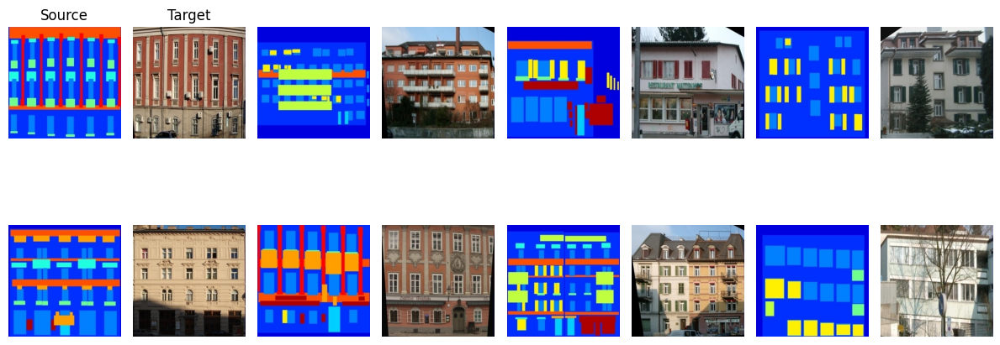

In [ ]:
batch = next(iter(dataloader))
show_batch_of_pairs(batch, nrows=2, ncols=4, figsize=(12, 6))

In [ ]:
class Discriminator(nn.Module):
    def __init__(self, input_shape=(3, 256,256), n_filters=16, n_blocks = 2):
        super().__init__()

        self.input_shape= input_shape
        n_channels = input_shape[0]
        self.n_filters = n_filters
        self.model = nn.Sequential(
            *self._block(n_channels * 2, n_filters, stride=2, normalize=False),
            *itertools.chain(*[self._block(n_filters * 2**(i), n_filters * 2**(i+1), stride=2) for i in range(n_blocks)]),
            *self._block(n_filters * 2**(n_blocks),n_filters * 2**(n_blocks+1), stride=1),
            nn.Conv2d(n_filters * 2**(n_blocks+1), 1, kernel_size=4, stride=1, padding=1),
        )
    def _block(self, in_filters, out_filters, stride, normalize=True):
        layers = [nn.Conv2d(in_filters, out_filters, kernel_size=4, stride=stride, padding=1)]
        if normalize:
            layers.append(nn.BatchNorm2d(out_filters))
        layers.append(nn.LeakyReLU(0.2, inplace=True))
        return layers
    def forward(self, img_A, img_B):
        img_input = torch.cat((img_A, img_B), dim=1)
        return self.model(img_input)


In [ ]:
discriminator = Discriminator(n_filters=64)
torchsummary.summary(discriminator,[img_shape, img_shape], device='cpu')

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 128, 128]           6,208
         LeakyReLU-2         [-1, 64, 128, 128]               0
            Conv2d-3          [-1, 128, 64, 64]         131,200
       BatchNorm2d-4          [-1, 128, 64, 64]             256
         LeakyReLU-5          [-1, 128, 64, 64]               0
            Conv2d-6          [-1, 256, 32, 32]         524,544
       BatchNorm2d-7          [-1, 256, 32, 32]             512
         LeakyReLU-8          [-1, 256, 32, 32]               0
            Conv2d-9          [-1, 512, 31, 31]       2,097,664
      BatchNorm2d-10          [-1, 512, 31, 31]           1,024
        LeakyReLU-11          [-1, 512, 31, 31]               0
           Conv2d-12            [-1, 1, 30, 30]           8,193
Total params: 2,769,601
Trainable params: 2,769,601
Non-trainable params: 0
---------------------------

In [ ]:
class Generator(nn.Module):
    def __init__(self, img_shape=(3, 256, 256), n_filters=16):
        super().__init__()

        self.n_filters = n_filters
        self.img_shape = img_shape
        n_channels = img_shape[0]
        n_blocks = int(np.log2(img_shape[1]) - 2)
        min_exp = 3

        self.encoder = nn.ModuleList([
            self._downblock(3, n_filters, normalization=False),
            *[self._downblock(n_filters * 2**(min(min_exp, i)), n_filters * 2**(min(min_exp, i+1))) for i in range(n_blocks)],
            self._downblock(n_filters * 2**min(min_exp, n_blocks), n_filters * 2**min(min_exp, n_blocks), normalization=False)
        ])

        self.decoder = nn.ModuleList([
            self._upblock(n_filters * 2**min(min_exp, n_blocks), n_filters * 2**min(min_exp, n_blocks)),
            *[self._upblock(n_filters * 2**(min(min_exp, i+1)) * 2, n_filters * 2**(min(min_exp, i))) for i in range(n_blocks-1, -1, -1)],
            self._upblock(n_filters * 2, n_channels, normalization=False, activation='tanh')
        ])

    def _downblock(self, in_channels, out_channels, normalization=True):
        layers = [nn.Conv2d(in_channels, out_channels, 4, 2, 1, bias=False, padding_mode='reflect')]
        if normalization:
            layers.append(nn.BatchNorm2d(out_channels))
        layers.append(nn.LeakyReLU(0.2, inplace=True))
        return nn.Sequential(*layers)

    def _upblock(self, in_channels, out_channels, normalization=True, activation='relu'):
        layers = [nn.ConvTranspose2d(in_channels, out_channels, 4, 2, 1, bias=False)]
        if normalization:
            layers.append(nn.BatchNorm2d(out_channels))
        if activation == 'relu':
            layers.append(nn.ReLU(inplace=True))
        elif activation == 'tanh':
            layers.append(nn.Tanh())
        return nn.Sequential(*layers)

    def forward(self, x):
        downs = []

        for model in self.encoder:
            x = model(x)
            downs.append(x)

        downs = downs[:-1][::-1]
        for i, model in enumerate(self.decoder):
            x = model(x)
            if i < len(downs):
                x = torch.cat([x, downs[i]], dim=1)

        return x

In [ ]:
generator= Generator()
torchsummary.summary(generator, img_shape, device='cpu')

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 16, 128, 128]             768
         LeakyReLU-2         [-1, 16, 128, 128]               0
            Conv2d-3           [-1, 32, 64, 64]           8,192
       BatchNorm2d-4           [-1, 32, 64, 64]              64
         LeakyReLU-5           [-1, 32, 64, 64]               0
            Conv2d-6           [-1, 64, 32, 32]          32,768
       BatchNorm2d-7           [-1, 64, 32, 32]             128
         LeakyReLU-8           [-1, 64, 32, 32]               0
            Conv2d-9          [-1, 128, 16, 16]         131,072
      BatchNorm2d-10          [-1, 128, 16, 16]             256
        LeakyReLU-11          [-1, 128, 16, 16]               0
           Conv2d-12            [-1, 128, 8, 8]         262,144
      BatchNorm2d-13            [-1, 128, 8, 8]             256
        LeakyReLU-14            [-1, 12

In [ ]:
class Pix2PixGAN(nn.Module):
    def __init__(self, img_shape=(3, 256,256), n_filters=16, disc_n_blocks=2):
        super().__init__()

        self.img_shape = img_shape
        self.n_filters = n_filters
        self.disc_n_blocks = disc_n_blocks

        self.discriminator = Discriminator(img_shape, n_filters, disc_n_blocks)
        self.generator = Generator(img_shape, n_filters)

    def forward(self, x):
        return self.generator(x)

    def save(self, folder_path):
        os.makedirs(folder_path, exist_ok=True)

        torch.save(self.generator.state_dict(), os.path.join(folder_path, "generator_weights.pth"))
        torch.save(self.discriminator.state_dict(), os.path.join(folder_path, "discriminator_weights.pth"))

        config = {
            'img_shape': self.img_shape,
            'n_filters': self.n_filters,
            'disc_n_blocks': self.disc_n_blocks,
        }
        with open(os.path.join(folder_path, "config.json"), "w") as f:
            json.dump(config, f, indent=4)

        print(f"GAN saved to folder: {folder_path}")

    @classmethod
    def from_pretrained(cls, folder_path):
        config_path = os.path.join(folder_path, "config.json")
        if not os.path.exists(config_path):
            raise FileNotFoundError(f"Config file not found: {config_path}")

        with open(config_path, "r") as f:
            config = json.load(f)

        disc_n_blocks = config['disc_n_blocks']
        n_filters = config['n_filters']
        img_shape = tuple(config['img_shape'])
        gan = cls(img_shape, n_filters, disc_n_blocks)

        generator_weights_path = os.path.join(folder_path, "generator_weights.pth")
        discriminator_weights_path = os.path.join(folder_path, "discriminator_weights.pth")

        if not os.path.exists(generator_weights_path):
            raise FileNotFoundError(f"Generator weights file not found: {generator_weights_path}")
        if not os.path.exists(discriminator_weights_path):
            raise FileNotFoundError(f"Critic weights file not found: {discriminator_weights_path}")

        gan.generator.load_state_dict(torch.load(generator_weights_path, weights_only=True))
        gan.discriminator.load_state_dict(torch.load(discriminator_weights_path, weights_only=True))

        print(f"GAN loaded from folder: {folder_path}")

        return gan


In [ ]:
class Pix2PixGANTrainer:
    def __init__(self, gan, config={}, device='cpu'):

        self.gan = gan
        self.config = config

        self.epochs = config.get('epochs', 5)
        self.lr = config.get('lr', 2e-4)
        self.recon_loss_coeff = config.get('recon_loss_coeff', 100)
        self.batch_size = config.get('batch_size', 64)
        self.sample_interval = config.get('sample_interval', 1)
        self.checkpoint_interval = config.get('checkpoint_interval', 1)
        self.push_to_hub = config.get('push_to_hub', False)
        if self.push_to_hub and not "repo_id" in config:
            raise ValueError('missing repo_id')
        self.repo_id = config.get('repo_id')
        self.device = device

        self.sample_dir = config.get('sample_dir', 'samples')
        self.checkpoint_dir = config.get('checkpoint_dir', 'checkpoints')

        os.makedirs(self.sample_dir, exist_ok=True)
        os.makedirs(self.checkpoint_dir, exist_ok=True)

        self.d_optimizer = torch.optim.Adam(self.gan.discriminator.parameters(), lr=self.lr, betas=(0.5, 0.999))
        self.g_optimizer = torch.optim.Adam(self.gan.generator.parameters(), lr=self.lr, betas=(0.5, 0.999))

        self.gan.to(self.device)

        self.criterion_gan = nn.MSELoss()
        self.criterion_recon = nn.L1Loss()
    def save_checkpoint(self, epoch):
        checkpoint_path = os.path.join(self.checkpoint_dir, f"checkpoint_epoch_{epoch}")
        os.makedirs(checkpoint_path, exist_ok=True)
        self.gan.save(checkpoint_path)
        torch.save(self.g_optimizer.state_dict(), os.path.join(checkpoint_path, 'g_optimizer.pth'))
        torch.save(self.d_optimizer.state_dict(), os.path.join(checkpoint_path, 'd_optimizer.pth'))
        if self.push_to_hub:
            hf_api.upload_folder(
                repo_id=self.repo_id,
                folder_path=checkpoint_path,
                path_in_repo=checkpoint_path,
            )
            hf_api.upload_folder(
                repo_id=self.repo_id,
                folder_path=checkpoint_path,
                path_in_repo=os.path.join(self.checkpoint_dir,'last_checkpoint'),
            )
        print('Checkpoint saved to ', checkpoint_path)
    def load_checkpoint(self, checkpoint_path):
        self.gan = Pix2PixGAN.from_pretrained(os.path.join(checkpoint_path))

        g_optimizer_path = os.path.join(checkpoint_path, 'g_optimizer.pth')
        d_optimizer_path = os.path.join(checkpoint_path, 'd_optimizer.pth')

        if os.path.exists(g_optimizer_path):
            self.g_optimizer.load_state_dict(torch.load(g_optimizer_path, map_location=self.device, weights_only=True))

        if os.path.exists(d_optimizer_path):
            self.d_optimizer.load_state_dict(torch.load(d_optimizer_path, map_location=self.device, weights_only=True))

        print(f"Checkpoint loaded from {checkpoint_path}")
    def save_samples(self, source_images, gen_images, target_images, epoch, limit_n=4):
        source_images = source_images.cpu()[:limit_n]
        gen_images = gen_images.cpu()[:limit_n]
        target_images = target_images.cpu()[:limit_n]

        triplets = torch.stack([source_images, gen_images, target_images], dim=1)
        triplets = triplets.view(-1, *source_images.shape[1:])

        grid = torchvision.utils.make_grid(triplets, nrow=3, normalize=True, scale_each=True)
        sample_path = os.path.join(self.sample_dir, f"epoch_{epoch}.png")
        torchvision.utils.save_image(grid, sample_path)

        plt.figure(figsize=(15, 5))
        plt.imshow(grid.permute(1, 2, 0))
        plt.axis("off")
        plt.title(f"Epoch {epoch}")
        plt.show()

        print(f"Saved sample to {sample_path}")

    def _train_epoch(self, train_loader):
        self.gan.train()

        total_d_loss = 0.
        total_g_loss = 0.
        total_recon_loss = 0.

        progress_bar = tqdm(train_loader, desc='Training',  leave=False)

        for source_images, target_images in progress_bar:
            source_images, target_images = source_images.to(self.device), target_images.to(self.device)

            self.d_optimizer.zero_grad()

            real_output = self.gan.discriminator(source_images, target_images)
            real_loss = self.criterion_gan(real_output, torch.ones_like(real_output, device=self.device))

            fake_images = self.gan.generator(source_images)
            fake_output = self.gan.discriminator(source_images, fake_images)
            fake_loss = self.criterion_gan(fake_output, torch.zeros_like(fake_output, device=self.device))
            d_loss = (real_loss + fake_loss) / 2

            d_loss.backward()
            self.d_optimizer.step()

            self.g_optimizer.zero_grad()

            fake_images = self.gan.generator(source_images)
            fake_output = self.gan.discriminator(source_images, fake_images)
            fake_loss = self.criterion_gan(fake_output, torch.ones_like(fake_output, device=self.device))

            recon_loss = self.criterion_recon(fake_images, target_images)
            g_loss = fake_loss + self.recon_loss_coeff * recon_loss

            g_loss.backward()
            self.g_optimizer.step()


            total_d_loss += d_loss.item()
            total_g_loss += g_loss.item()
            total_recon_loss += recon_loss.item()
            progress_bar.set_postfix({'d_loss':d_loss.item(), 'g_loss':g_loss.item(), 'recon_loss': recon_loss.item()})

        return {
            'd_loss': total_d_loss / len(train_loader),
            'g_loss': total_g_loss / len(train_loader),
            'recon_loss': total_recon_loss / len(train_loader),
        }
    def validate(self, val_loader):
        self.gan.eval()
        total_d_loss = 0.
        total_g_loss = 0.
        total_recon_loss = 0.
        with torch.no_grad():
            for source_images, target_images in tqdm(val_loader, desc="Validating", leave=False):
                source_images, target_images = source_images.to(self.device), target_images.to(self.device)

                fake_images = self.gan.generator(source_images)

                real_output = self.gan.discriminator(source_images, target_images)
                fake_output = self.gan.discriminator(source_images, fake_images)
                real_loss = self.criterion_gan(real_output, torch.ones_like(real_output, device=self.device))
                fake_loss = self.criterion_gan(fake_output, torch.zeros_like(fake_output, device=self.device))
                d_loss = (real_loss + fake_loss) / 2

                fake_loss = self.criterion_gan(fake_output, torch.ones_like(fake_output, device=self.device))
                recon_loss = self.criterion_recon(fake_images, target_images)
                g_loss = fake_loss + self.recon_loss_coeff * recon_loss

                total_d_loss += d_loss.item()
                total_g_loss += g_loss.item()
                total_recon_loss += recon_loss.item()
        return {
            'd_loss': total_d_loss / len(val_loader),
            'g_loss': total_g_loss / len(val_loader),
            'recon_loss': total_recon_loss / len(val_loader),
        }
    def train(self, train_loader, val_loader=None):
        train_history = []
        val_history = []
        for epoch in tqdm(range(self.epochs)):
            print(f'Epoch {epoch + 1}')
            train_losses = self._train_epoch(train_loader)
            d_loss = train_losses['d_loss']
            g_loss = train_losses['g_loss']
            recon_loss = train_losses['recon_loss']
            train_history.append(train_losses)


            print(f'Training: D loss: {d_loss}, G loss: {g_loss}, Recon loss: {recon_loss}')
            if val_loader:
                val_losses = self.validate(val_loader)
                d_loss = val_losses['d_loss']
                g_loss = val_losses['g_loss']
                recon_loss = val_losses['recon_loss']
                print(f'Validation: D loss: {d_loss}, G loss: {g_loss}, Recon loss: {recon_loss}')
                val_history.append(val_losses)

            if epoch % self.checkpoint_interval == 0:
                self.save_checkpoint(epoch)
            if epoch % self.sample_interval == 0:
                source_images, target_images = next(iter(val_loader))
                source_images, target_images = source_images.to(device), target_images.to(device)
                self.save_samples(source_images, self.gan.generator(source_images), target_images, epoch)
        if val_loader:
            return train_history, val_history
        return train_history


In [ ]:
gan = Pix2PixGAN(img_shape, n_filters=64)
batch_size = 16
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(validation_dataset, batch_size=batch_size)

In [ ]:
import torch
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

trainer = Pix2PixGANTrainer(gan,device=device, config={
    'lr':2e-4,
    'recon_loss_coeff': 100,
    'epochs': 180,
    'batch_size': batch_size,
    'sample_interval': 10,
    'checkpoint_interval': 20,
    'sample_dir': 'samples',
    'checkpoint_dir': 'label2facade/checkpoints',
    'push_to_hub': False,
})

Using device: cuda


  0%|          | 0/180 [00:00<?, ?it/s]

Epoch 1


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.4224062019586563, G loss: 44.13142990112305, Recon loss: 0.4357983958721161


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.310833283833095, G loss: 37.000770568847656, Recon loss: 0.3672516942024231
GAN saved to folder: label2facade/checkpoints/checkpoint_epoch_0
Checkpoint saved to  label2facade/checkpoints/checkpoint_epoch_0


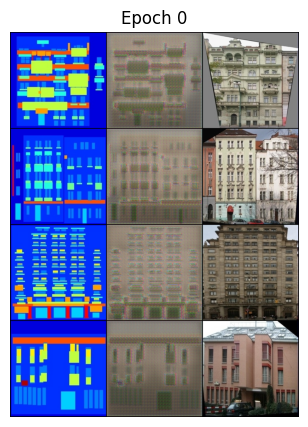

Saved sample to samples/epoch_0.png
Epoch 2


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.20536866426467895, G loss: 36.83047760009766, Recon loss: 0.3635999262332916


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.41963753529957365, G loss: 35.453190667288645, Recon loss: 0.35156157187053133
Epoch 3


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.16444712072610856, G loss: 36.16705078125, Recon loss: 0.3554921162128448


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.6362543191228595, G loss: 34.979004451206755, Recon loss: 0.34729874985558645
Epoch 4


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.11563372865319252, G loss: 35.889290466308594, Recon loss: 0.35108981728553773


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.311733888728278, G loss: 34.83160073416574, Recon loss: 0.34459338443619864
Epoch 5


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.10834085732698441, G loss: 35.55545471191406, Recon loss: 0.3470806467533112


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.27182796597480774, G loss: 34.39566666739328, Recon loss: 0.33992293902805876
Epoch 6


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.10036496505141258, G loss: 35.15734802246094, Recon loss: 0.34444836735725404


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.30047992297581266, G loss: 33.97267723083496, Recon loss: 0.33651923281805857
Epoch 7


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.11193954944610596, G loss: 34.89441452026367, Recon loss: 0.3408158135414123


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.3818613035338266, G loss: 34.95326369149344, Recon loss: 0.340745781149183
Epoch 8


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.08571363575756549, G loss: 34.88838684082031, Recon loss: 0.34045331716537475


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2842663313661303, G loss: 33.36789921351841, Recon loss: 0.3290903866291046
Epoch 9


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.06437125012278556, G loss: 34.41099731445313, Recon loss: 0.33542152881622317


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.25498174130916595, G loss: 34.27698407854353, Recon loss: 0.3397922430719648
Epoch 10


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.08461892731487751, G loss: 34.19865081787109, Recon loss: 0.3331731367111206


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.26282734530312674, G loss: 32.160700934273855, Recon loss: 0.316546802009855
Epoch 11


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.06708761289715767, G loss: 33.42181266784668, Recon loss: 0.32503788590431215


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.3461384986128126, G loss: 33.294572830200195, Recon loss: 0.32605244857924326


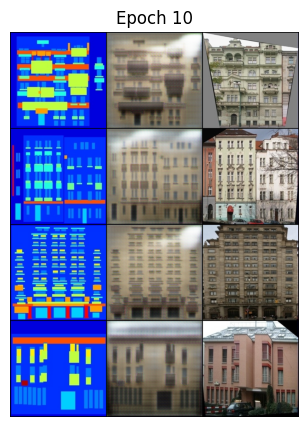

Saved sample to samples/epoch_10.png
Epoch 12


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.06496787622570992, G loss: 33.16968406677246, Recon loss: 0.3227093505859375


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.3625394659382956, G loss: 31.07849666050502, Recon loss: 0.30477423327309744
Epoch 13


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.038777779787778854, G loss: 32.61015243530274, Recon loss: 0.3167631018161774


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.26221561431884766, G loss: 30.579098565237864, Recon loss: 0.3009559384414128
Epoch 14


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.055331860706210136, G loss: 32.209009628295895, Recon loss: 0.31283515095710757


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2787206300667354, G loss: 29.98080062866211, Recon loss: 0.2938941206250872
Epoch 15


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.04944871634244919, G loss: 31.926630935668946, Recon loss: 0.3097382140159607


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.32845589092799593, G loss: 30.06526075090681, Recon loss: 0.29486345393317087
Epoch 16


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.11802943114191294, G loss: 31.306014251708984, Recon loss: 0.30346915125846863


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 1.7059322084699358, G loss: 31.907756805419922, Recon loss: 0.31173944047519137
Epoch 17


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.3188123083114624, G loss: 30.311869812011718, Recon loss: 0.29644472360610963


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.23656101524829865, G loss: 27.968197958809988, Recon loss: 0.27540805297238485
Epoch 18


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.04653546698391438, G loss: 29.882210998535157, Recon loss: 0.29058453559875486


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2535321797643389, G loss: 27.75766399928502, Recon loss: 0.27252011852605
Epoch 19


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.08374258510768413, G loss: 29.792453231811525, Recon loss: 0.2892388725280762


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2541331308228629, G loss: 27.358264650617325, Recon loss: 0.2690449612481253
Epoch 20


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.022140157148241996, G loss: 29.414413986206053, Recon loss: 0.2847944581508636


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.3840423268931253, G loss: 26.779639652797155, Recon loss: 0.2603215617792947
Epoch 21


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.033656452968716624, G loss: 28.854186019897462, Recon loss: 0.2792781060934067


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.31004121048109873, G loss: 26.031198501586914, Recon loss: 0.2557080920253481
GAN saved to folder: label2facade/checkpoints/checkpoint_epoch_20
Checkpoint saved to  label2facade/checkpoints/checkpoint_epoch_20


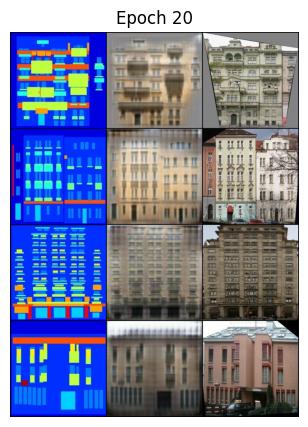

Saved sample to samples/epoch_20.png
Epoch 22


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.026422161273658276, G loss: 28.22019218444824, Recon loss: 0.2728178584575653


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.28951119099344524, G loss: 25.89949689592634, Recon loss: 0.2541542947292328
Epoch 23


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.05740307323634625, G loss: 27.64431785583496, Recon loss: 0.2674048590660095


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.3551974041121347, G loss: 25.943872724260604, Recon loss: 0.25360605333532604
Epoch 24


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.03093720281496644, G loss: 27.24774299621582, Recon loss: 0.26323566675186155


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2607756086758205, G loss: 24.780835560389928, Recon loss: 0.2437435473714556
Epoch 25


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.03632404152303934, G loss: 27.07547332763672, Recon loss: 0.2612482666969299


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.3601326516696385, G loss: 24.928359712873185, Recon loss: 0.24339676754815237
Epoch 26


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.04558043833822012, G loss: 26.821202545166017, Recon loss: 0.25905349254608157


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2597878021853311, G loss: 24.646271569388254, Recon loss: 0.24252582447869436
Epoch 27


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.03767594687640667, G loss: 26.131572875976563, Recon loss: 0.25193203926086427


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.242427796125412, G loss: 23.534326008387975, Recon loss: 0.23236012245927537
Epoch 28


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.05435861434787512, G loss: 25.662400436401366, Recon loss: 0.2472634071111679


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.28224270258631023, G loss: 23.15536962236677, Recon loss: 0.22686084466321127
Epoch 29


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.0512623431161046, G loss: 25.11718589782715, Recon loss: 0.2421306002140045


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.27870302540915354, G loss: 22.932419640677317, Recon loss: 0.2253756778580802
Epoch 30


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.02658502062782645, G loss: 24.477063446044923, Recon loss: 0.23544962584972381


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.29164911593709675, G loss: 22.20075035095215, Recon loss: 0.2166986401591982
Epoch 31


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.06772000573575497, G loss: 23.802882843017578, Recon loss: 0.22873421192169188


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.28842725498335703, G loss: 21.680544716971262, Recon loss: 0.21179817191192082


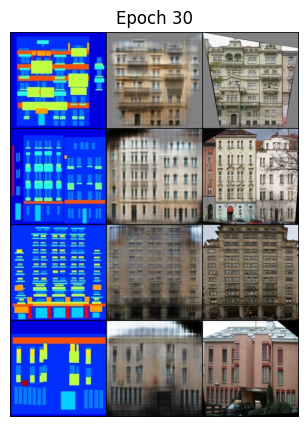

Saved sample to samples/epoch_30.png
Epoch 32


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.04390883237123489, G loss: 23.74028465270996, Recon loss: 0.22800104916095734


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2661590278148651, G loss: 22.083533695765905, Recon loss: 0.21637011212962015
Epoch 33


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.07031656585633755, G loss: 23.10568572998047, Recon loss: 0.22233682572841645


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2832921828542437, G loss: 20.80371148245675, Recon loss: 0.20373280772141047
Epoch 34


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.052816226072609426, G loss: 22.825271224975587, Recon loss: 0.2193244642019272


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2510632744857243, G loss: 20.6247683933803, Recon loss: 0.20198612340859004
Epoch 35


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.07373865120112896, G loss: 22.533385772705078, Recon loss: 0.21636472821235656


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.24606959308896745, G loss: 20.299950190952845, Recon loss: 0.19850230642727443
Epoch 36


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.06824630782008172, G loss: 21.851759567260743, Recon loss: 0.2096606981754303


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.25094624289444517, G loss: 20.370007923671178, Recon loss: 0.19946213492325374
Epoch 37


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.0555686455219984, G loss: 22.02029495239258, Recon loss: 0.21129117369651795


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.23888816578047617, G loss: 20.392330987112864, Recon loss: 0.19942278734275273
Epoch 38


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.06797094523906708, G loss: 21.4944189453125, Recon loss: 0.20606478452682495


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.3158507985728128, G loss: 19.83403778076172, Recon loss: 0.19253361438001906
Epoch 39


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.06130644127726555, G loss: 20.767588806152343, Recon loss: 0.1987705260515213


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.22557046370846884, G loss: 19.03757313319615, Recon loss: 0.18748438784054347
Epoch 40


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.051853060349822046, G loss: 20.97174674987793, Recon loss: 0.20032140851020813


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.314788635287966, G loss: 19.51155608040946, Recon loss: 0.1891785583325795
Epoch 41


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.10444620110094548, G loss: 20.42093551635742, Recon loss: 0.19573594450950624


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.32128083280154635, G loss: 18.531206675938197, Recon loss: 0.17999712271349771
GAN saved to folder: label2facade/checkpoints/checkpoint_epoch_40
Checkpoint saved to  label2facade/checkpoints/checkpoint_epoch_40


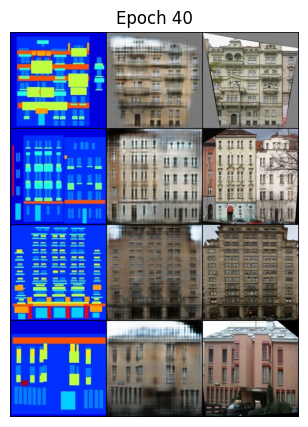

Saved sample to samples/epoch_40.png
Epoch 42


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.06568434786051512, G loss: 20.334729766845705, Recon loss: 0.19460740447044372


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.23640861894403184, G loss: 19.135940551757812, Recon loss: 0.18739366318498338
Epoch 43


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.08805183559656143, G loss: 20.036666717529297, Recon loss: 0.1916843169927597


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2569121633257185, G loss: 18.001082556588308, Recon loss: 0.1754568006311144
Epoch 44


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.09602257445454597, G loss: 19.759787521362306, Recon loss: 0.1890776890516281


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.3678202245916639, G loss: 18.727635519845144, Recon loss: 0.1821915273155485
Epoch 45


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.09202426351606846, G loss: 19.701057891845704, Recon loss: 0.1886863660812378


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.252988087279456, G loss: 17.81926700047084, Recon loss: 0.17389070774827683
Epoch 46


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.05520283408463001, G loss: 19.013412399291994, Recon loss: 0.18154950320720672


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.28990198033196585, G loss: 17.613419941493444, Recon loss: 0.16994252588067735
Epoch 47


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.10934257484972477, G loss: 18.97961097717285, Recon loss: 0.18147231817245482


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.3098550524030413, G loss: 18.108898435320175, Recon loss: 0.17482510847704752
Epoch 48


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.15636113572865726, G loss: 18.98103469848633, Recon loss: 0.18148072600364684


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.6922059059143066, G loss: 17.484254019601003, Recon loss: 0.17004268510001047
Epoch 49


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.07830331537872554, G loss: 18.332231826782227, Recon loss: 0.17500742733478547


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.24454571306705475, G loss: 16.671166011265345, Recon loss: 0.1626628509589604
Epoch 50


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.0494316466897726, G loss: 18.265071868896484, Recon loss: 0.1742507380247116


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.26335038457598003, G loss: 16.408192770821707, Recon loss: 0.15875186451843806
Epoch 51


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.0969631190598011, G loss: 17.986550941467286, Recon loss: 0.17127040565013885


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.36209219694137573, G loss: 16.047444616045272, Recon loss: 0.15385017437594278


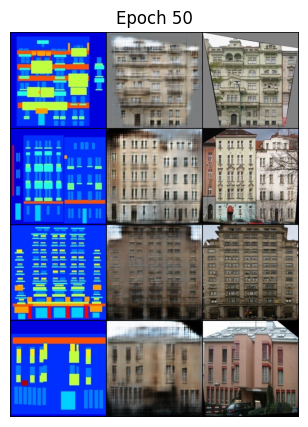

Saved sample to samples/epoch_50.png
Epoch 52


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.07046501632779836, G loss: 17.80908676147461, Recon loss: 0.17020300388336182


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.23636625707149506, G loss: 16.342156682695663, Recon loss: 0.1597198418208531
Epoch 53


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.11903011068701744, G loss: 17.99278274536133, Recon loss: 0.17182243824005128


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.34465899637767244, G loss: 16.500710351126536, Recon loss: 0.15868596945490157
Epoch 54


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.08511123158037663, G loss: 17.536234664916993, Recon loss: 0.16709806084632872


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.25789076515606474, G loss: 15.6323516028268, Recon loss: 0.1515796801873616
Epoch 55


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.08922197006642818, G loss: 17.34635070800781, Recon loss: 0.16561710476875305


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2385507311139788, G loss: 15.542907169886998, Recon loss: 0.15167849830218724
Epoch 56


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.095504250228405, G loss: 17.124942741394044, Recon loss: 0.163146932721138


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.243499327983175, G loss: 16.060600689479283, Recon loss: 0.15592777941908156
Epoch 57


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.11268198825418949, G loss: 16.98345802307129, Recon loss: 0.1616444194316864


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.26858377882412504, G loss: 15.516800607953753, Recon loss: 0.15053296302046096
Epoch 58


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.09566206760704517, G loss: 17.14199630737305, Recon loss: 0.16350577712059022


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.23399172723293304, G loss: 15.203558649335589, Recon loss: 0.14832176268100739
Epoch 59


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.11723466284573078, G loss: 16.80825912475586, Recon loss: 0.1602956795692444


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2948123259203775, G loss: 15.326046807425362, Recon loss: 0.14744778403214046
Epoch 60


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.08082375712692738, G loss: 16.52658435821533, Recon loss: 0.15717484235763549


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.28084955896650043, G loss: 15.03983633858817, Recon loss: 0.14499943809849875
Epoch 61


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.09291809499263763, G loss: 16.364509086608887, Recon loss: 0.15573189198970794


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2839646765163967, G loss: 14.93675436292376, Recon loss: 0.1445992695433753
GAN saved to folder: label2facade/checkpoints/checkpoint_epoch_60
Checkpoint saved to  label2facade/checkpoints/checkpoint_epoch_60


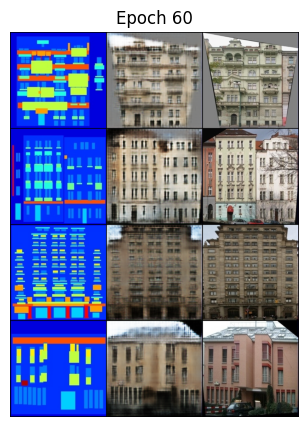

Saved sample to samples/epoch_60.png
Epoch 62


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.11894628599286079, G loss: 16.50521583557129, Recon loss: 0.1572067469358444


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.24709637675966536, G loss: 14.689600672040667, Recon loss: 0.1421541167157037
Epoch 63


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.1089560927450657, G loss: 16.21834831237793, Recon loss: 0.15408670365810395


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.300408878496715, G loss: 14.311691284179688, Recon loss: 0.13776881779943193
Epoch 64


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.0961514026671648, G loss: 16.002348480224608, Recon loss: 0.152294562458992


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.24983524424689157, G loss: 13.945693288530622, Recon loss: 0.13600814768246242
Epoch 65


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.0891889701783657, G loss: 15.85941390991211, Recon loss: 0.15064463436603545


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.282408139535359, G loss: 14.965568678719658, Recon loss: 0.14464130784784043
Epoch 66


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.13676526814699172, G loss: 15.858144226074218, Recon loss: 0.15102826952934265


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2410090927566801, G loss: 13.788408551897321, Recon loss: 0.13463945473943437
Epoch 67


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.08552291259169578, G loss: 15.783340911865235, Recon loss: 0.1500624203681946


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.25431897810527254, G loss: 14.585917745317731, Recon loss: 0.1409788876771927
Epoch 68


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.12796138539910318, G loss: 15.497510833740234, Recon loss: 0.14774970173835755


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.23676473753792898, G loss: 14.442460468837194, Recon loss: 0.1400549922670637
Epoch 69


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.0917756399512291, G loss: 15.254370460510254, Recon loss: 0.14498043715953826


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.23227069207600184, G loss: 13.828974178859166, Recon loss: 0.1339555989418711
Epoch 70


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.10781620278954505, G loss: 15.216314697265625, Recon loss: 0.1444169694185257


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.33298701899392263, G loss: 14.291512625558036, Recon loss: 0.13592954192842757
Epoch 71


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.12000723287463189, G loss: 15.291650581359864, Recon loss: 0.1457027804851532


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.23964891263416835, G loss: 13.511329514639717, Recon loss: 0.13245077111891337


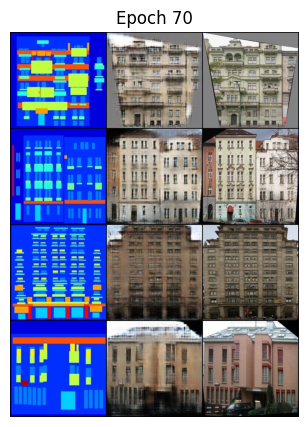

Saved sample to samples/epoch_70.png
Epoch 72


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.08829615607857705, G loss: 15.107913398742676, Recon loss: 0.14338122606277465


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.37150552443095614, G loss: 14.081146240234375, Recon loss: 0.1335652225783893
Epoch 73


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.14374118283391, G loss: 15.454214820861816, Recon loss: 0.1472679030895233


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2789897620677948, G loss: 13.714214733668737, Recon loss: 0.13164861926010676
Epoch 74


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.0937515413761139, G loss: 14.967030639648437, Recon loss: 0.14284517288208007


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.22770045484815324, G loss: 13.799415997096471, Recon loss: 0.13467675660337722
Epoch 75


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.1353536856174469, G loss: 14.812117118835449, Recon loss: 0.14086998939514161


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.26099625655582975, G loss: 13.784469876970563, Recon loss: 0.13231839133160456
Epoch 76


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.10582863718271256, G loss: 14.67115535736084, Recon loss: 0.13944839119911193


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.25343139256749836, G loss: 13.529092379978724, Recon loss: 0.13043059834412166
Epoch 77


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.14944763347506523, G loss: 14.486274833679198, Recon loss: 0.1376756274700165


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.31024123089654104, G loss: 13.598201070513044, Recon loss: 0.1320814405168806
Epoch 78


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.10116329908370972, G loss: 14.339379425048827, Recon loss: 0.13627135634422302


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.224943893296378, G loss: 13.297915049961635, Recon loss: 0.12916804211480276
Epoch 79


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.11817236304283142, G loss: 14.584586868286133, Recon loss: 0.13881419956684113


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.23182589454310282, G loss: 12.872434343610491, Recon loss: 0.1242367263351168
Epoch 80


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.11041672885417939, G loss: 14.11711826324463, Recon loss: 0.13413417994976043


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.25294519109385355, G loss: 13.020359448024205, Recon loss: 0.12457398431641716
Epoch 81


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.10103467717766762, G loss: 14.186934852600098, Recon loss: 0.13477307856082915


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.22534059626715525, G loss: 12.571270942687988, Recon loss: 0.12206804326602391
GAN saved to folder: label2facade/checkpoints/checkpoint_epoch_80
Checkpoint saved to  label2facade/checkpoints/checkpoint_epoch_80


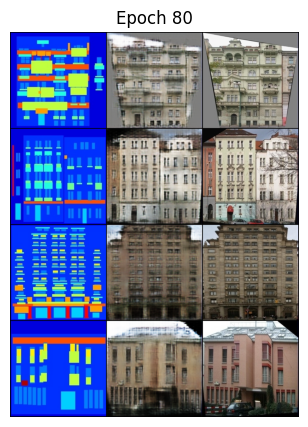

Saved sample to samples/epoch_80.png
Epoch 82


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.11329332768917083, G loss: 14.213121871948243, Recon loss: 0.13514844596385955


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2569298105580466, G loss: 13.150421278817314, Recon loss: 0.12644010250057494
Epoch 83


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.14444604203104972, G loss: 14.447297477722168, Recon loss: 0.13748419642448426


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2735020731176649, G loss: 13.042393684387207, Recon loss: 0.12451969512871333
Epoch 84


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.09881538555026054, G loss: 14.12932846069336, Recon loss: 0.1345300108194351


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.3598209662096841, G loss: 12.973605837140765, Recon loss: 0.12221686967781611
Epoch 85


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.13885568529367448, G loss: 13.876555786132812, Recon loss: 0.13228680253028868


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2366511928183692, G loss: 13.017538070678711, Recon loss: 0.1254565098455974
Epoch 86


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.1468699935078621, G loss: 13.849495849609376, Recon loss: 0.13149309694766997


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2398707334484373, G loss: 13.091830117361885, Recon loss: 0.1265899326120104
Epoch 87


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.11021101877093314, G loss: 13.580501594543456, Recon loss: 0.12895845025777816


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.21798280094351088, G loss: 12.38662474496024, Recon loss: 0.1195068114570209
Epoch 88


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.7768603748083115, G loss: 14.06664451599121, Recon loss: 0.1276501026749611


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.5283830974783216, G loss: 12.083697727748326, Recon loss: 0.11456884124449321
Epoch 89


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.26682000458240507, G loss: 12.250314407348633, Recon loss: 0.11971107631921768


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.25283231905528475, G loss: 11.262410163879395, Recon loss: 0.11006419892821993
Epoch 90


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.24591361463069916, G loss: 12.166503944396972, Recon loss: 0.11894854664802551


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.26049614804131643, G loss: 11.143902914864677, Recon loss: 0.10807185832943235
Epoch 91


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.23704803705215455, G loss: 12.264390869140625, Recon loss: 0.1198010903596878


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.24342993540423258, G loss: 11.190675871712822, Recon loss: 0.10907150059938431


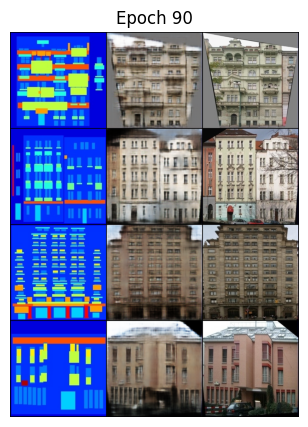

Saved sample to samples/epoch_90.png
Epoch 92


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.23225694596767427, G loss: 12.191303024291992, Recon loss: 0.11853202313184738


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.24137618499142782, G loss: 11.178306443350655, Recon loss: 0.10896555440766471
Epoch 93


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.1752828460931778, G loss: 12.209893417358398, Recon loss: 0.11835279583930969


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.37567976117134094, G loss: 10.998864037649971, Recon loss: 0.10689769153084074
Epoch 94


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.16466759651899338, G loss: 12.162648582458496, Recon loss: 0.11655005991458893


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2582292684486934, G loss: 10.99148941040039, Recon loss: 0.10593683804784503
Epoch 95


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.18582575142383576, G loss: 12.2062451171875, Recon loss: 0.11551415145397187


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2446293639285224, G loss: 11.312262262616839, Recon loss: 0.10917253579412188
Epoch 96


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.09768137797713279, G loss: 12.225417823791505, Recon loss: 0.1155937784910202


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.28126601236207144, G loss: 10.803127425057548, Recon loss: 0.10452800669840404
Epoch 97


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.11320533275604248, G loss: 12.4095890045166, Recon loss: 0.11760188549757004


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2948127942425864, G loss: 11.415724618094307, Recon loss: 0.1091319705758776
Epoch 98


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.12535792142152785, G loss: 12.212346305847168, Recon loss: 0.11547765612602234


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2672866242272513, G loss: 11.33482197352818, Recon loss: 0.10990115574428014
Epoch 99


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.1532517698407173, G loss: 12.3871000289917, Recon loss: 0.11761340469121934


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.25132827035018374, G loss: 11.570062909807477, Recon loss: 0.11151499620505742
Epoch 100


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.14366340920329093, G loss: 12.554441986083985, Recon loss: 0.11949416816234588


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.25249344961983816, G loss: 11.128873825073242, Recon loss: 0.10734137892723083
Epoch 101


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.14274845987558366, G loss: 12.450667495727538, Recon loss: 0.11837821215391159


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.24220233517033712, G loss: 11.156275204249791, Recon loss: 0.10854147693940572
GAN saved to folder: label2facade/checkpoints/checkpoint_epoch_100
Checkpoint saved to  label2facade/checkpoints/checkpoint_epoch_100


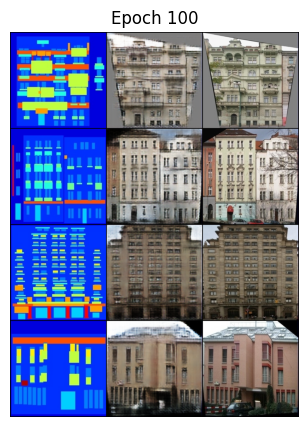

Saved sample to samples/epoch_100.png
Epoch 102


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.13381148740649224, G loss: 12.30827049255371, Recon loss: 0.1171480992436409


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2408635254417147, G loss: 10.980664661952428, Recon loss: 0.10617744603327342
Epoch 103


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.16235192567110063, G loss: 12.156950874328613, Recon loss: 0.11542016386985779


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2531412286417825, G loss: 11.410258293151855, Recon loss: 0.1098317780664989
Epoch 104


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.1456511774659157, G loss: 12.166259574890137, Recon loss: 0.1156695231795311


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.23732514679431915, G loss: 11.056399481637138, Recon loss: 0.10670480238539833
Epoch 105


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.1494433516263962, G loss: 11.993501281738281, Recon loss: 0.11421564519405365


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.25001998245716095, G loss: 11.0558260508946, Recon loss: 0.10688975666250501
Epoch 106


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.17470997840166091, G loss: 12.080023918151856, Recon loss: 0.11496731251478196


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2542104146310261, G loss: 10.989063262939453, Recon loss: 0.10699533990451268
Epoch 107


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.11912507832050323, G loss: 12.108805961608887, Recon loss: 0.11542217165231705


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.23299398805413926, G loss: 11.287107603890556, Recon loss: 0.10920237643378121
Epoch 108


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.1658484172821045, G loss: 12.152916259765625, Recon loss: 0.11598176389932632


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2947137951850891, G loss: 10.908068793160576, Recon loss: 0.10339512463126864
Epoch 109


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.14692867264151574, G loss: 11.938162269592285, Recon loss: 0.1136403352022171


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.24029052470411574, G loss: 10.817282949175153, Recon loss: 0.10508612756218229
Epoch 110


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.1595703960955143, G loss: 12.135800590515137, Recon loss: 0.11540336281061173


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.23877820585455214, G loss: 10.767504964556013, Recon loss: 0.10409870318004064
Epoch 111


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.13883641064167024, G loss: 12.076552352905274, Recon loss: 0.11532969862222671


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.24737648240157536, G loss: 10.788225991385323, Recon loss: 0.10536265905414309


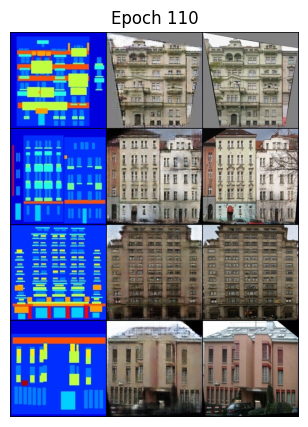

Saved sample to samples/epoch_110.png
Epoch 112


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.17013456627726556, G loss: 11.911799392700196, Recon loss: 0.11320217847824096


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.27358422534806387, G loss: 10.961108616420201, Recon loss: 0.10441576157297407
Epoch 113


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.14602708905935288, G loss: 11.940653686523438, Recon loss: 0.11379943579435349


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.23892106115818024, G loss: 10.79000459398542, Recon loss: 0.10495994452919279
Epoch 114


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.14781787514686584, G loss: 11.918938369750977, Recon loss: 0.11393307954072952


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.24186804039137705, G loss: 10.613374437604632, Recon loss: 0.1034878162401063
Epoch 115


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.15587564051151276, G loss: 11.800109367370606, Recon loss: 0.11245779931545258


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.25387031052793774, G loss: 11.201275961739677, Recon loss: 0.1079344494002206
Epoch 116


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.20798514723777772, G loss: 11.755107994079589, Recon loss: 0.11186048448085785


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.24852896162441798, G loss: 10.371600559779576, Recon loss: 0.1003856850521905
Epoch 117


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.14618101254105567, G loss: 11.588796768188477, Recon loss: 0.11006579488515854


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2510354880775724, G loss: 11.016847610473633, Recon loss: 0.10646960245711463
Epoch 118


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.14808373928070068, G loss: 11.498276176452636, Recon loss: 0.10964802563190461


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.24064605150903975, G loss: 10.404266221182686, Recon loss: 0.10093280353716441
Epoch 119


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.15747801288962365, G loss: 11.640953483581542, Recon loss: 0.11114652395248413


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.23428275968347276, G loss: 10.32805074964251, Recon loss: 0.09981500144515719
Epoch 120


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.16882183998823166, G loss: 11.459439010620118, Recon loss: 0.10884799629449844


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2612179900918688, G loss: 10.64883381979806, Recon loss: 0.10173505225351878
Epoch 121


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.17004220813512802, G loss: 11.417581253051758, Recon loss: 0.10849519968032836


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2628642107759203, G loss: 10.488637106759208, Recon loss: 0.10007991109575544
GAN saved to folder: label2facade/checkpoints/checkpoint_epoch_120
Checkpoint saved to  label2facade/checkpoints/checkpoint_epoch_120


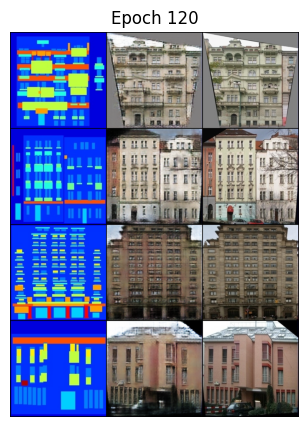

Saved sample to samples/epoch_120.png
Epoch 122


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.15079517006874085, G loss: 11.547091789245606, Recon loss: 0.11020289152860642


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.24138536623546056, G loss: 10.420688492911202, Recon loss: 0.10015287037406649
Epoch 123


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.17520765587687492, G loss: 11.295879135131836, Recon loss: 0.10769439429044723


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2393277415207454, G loss: 10.254218646458217, Recon loss: 0.09896071361643928
Epoch 124


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.15428778409957886, G loss: 11.593303985595703, Recon loss: 0.11047113537788392


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.24000532073634012, G loss: 10.615239415849958, Recon loss: 0.1020527673619134
Epoch 125


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.176088088452816, G loss: 11.502247543334962, Recon loss: 0.10968102633953095


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2407999187707901, G loss: 10.520898818969727, Recon loss: 0.10174740744488579
Epoch 126


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.1364048919081688, G loss: 11.214754447937011, Recon loss: 0.10692047417163848


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.24475248796599253, G loss: 10.204915182931083, Recon loss: 0.09918771577732903
Epoch 127


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.16441354393959046, G loss: 11.140082359313965, Recon loss: 0.10606345862150192


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.23687330526965006, G loss: 10.34582451411656, Recon loss: 0.09999783762863704
Epoch 128


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.19512758523225784, G loss: 11.190120887756347, Recon loss: 0.10683760374784469


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.24338201114109584, G loss: 10.091001238141741, Recon loss: 0.09773202879088265
Epoch 129


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.1478498375415802, G loss: 11.113417205810547, Recon loss: 0.10606802135705948


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.23644003484930312, G loss: 10.276538303920201, Recon loss: 0.09959976907287325
Epoch 130


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.1627548587322235, G loss: 11.016917915344239, Recon loss: 0.10495159447193146


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.24262049794197083, G loss: 9.952590806143624, Recon loss: 0.09573502093553543
Epoch 131


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.1699063065648079, G loss: 11.166232147216796, Recon loss: 0.10637683451175689


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.24974103271961212, G loss: 10.553152629307338, Recon loss: 0.10155206812279564


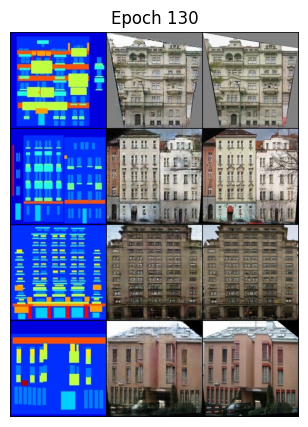

Saved sample to samples/epoch_130.png
Epoch 132


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.15056098580360414, G loss: 11.143467254638672, Recon loss: 0.1065580639243126


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.23837152336324965, G loss: 9.905214309692383, Recon loss: 0.09614386515957969
Epoch 133


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.154973521232605, G loss: 11.10265224456787, Recon loss: 0.10608777463436127


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.23811164711202895, G loss: 10.219748769487653, Recon loss: 0.09822993406227656
Epoch 134


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.20151867240667343, G loss: 11.132644653320312, Recon loss: 0.10589347332715988


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.24042503110000066, G loss: 9.552629607064384, Recon loss: 0.09199672511645726
Epoch 135


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.14255087792873383, G loss: 10.901782188415527, Recon loss: 0.10365007638931274


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2370496541261673, G loss: 9.895316396440778, Recon loss: 0.09504752925464086
Epoch 136


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.21096303761005403, G loss: 10.892232322692871, Recon loss: 0.10319088339805603


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 2.3770967551640103, G loss: 10.478403500148229, Recon loss: 0.09325521120003291
Epoch 137


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.6282145428657532, G loss: 10.733510589599609, Recon loss: 0.0992406976222992


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.26827085869652884, G loss: 9.205966404506139, Recon loss: 0.08946335102830615
Epoch 138


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.19038068115711212, G loss: 9.921803588867187, Recon loss: 0.09581460535526276


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.26151131306375774, G loss: 8.99841799054827, Recon loss: 0.08733459668500083
Epoch 139


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.15567027926445007, G loss: 9.894251289367675, Recon loss: 0.0947585716843605


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.26762499128069195, G loss: 8.987414632524763, Recon loss: 0.08652236844812121
Epoch 140


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.13577575117349625, G loss: 9.976590423583984, Recon loss: 0.09438925206661225


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.313113591500691, G loss: 9.309372356959752, Recon loss: 0.08779960232121604
Epoch 141


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.11040762811899185, G loss: 10.057582244873046, Recon loss: 0.09486985594034195


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2515617438725063, G loss: 9.25411878313337, Recon loss: 0.08886928749935967
GAN saved to folder: label2facade/checkpoints/checkpoint_epoch_140
Checkpoint saved to  label2facade/checkpoints/checkpoint_epoch_140


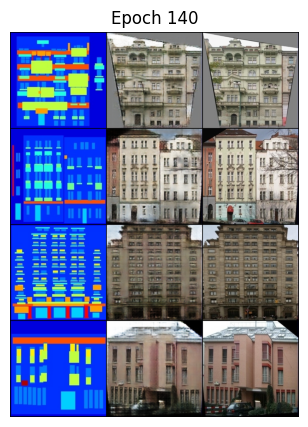

Saved sample to samples/epoch_140.png
Epoch 142


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.15906186103820802, G loss: 10.1954056930542, Recon loss: 0.09649115800857544


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2555788627692631, G loss: 9.34372956412179, Recon loss: 0.08979134048734393
Epoch 143


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.15412679553031922, G loss: 10.398945121765136, Recon loss: 0.09900646269321442


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2396459643329893, G loss: 9.140403202601842, Recon loss: 0.08830103278160095
Epoch 144


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.15236854553222656, G loss: 10.281047248840332, Recon loss: 0.09778796762228012


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.24374744934695108, G loss: 9.823496001107353, Recon loss: 0.09528867581060954
Epoch 145


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.16996730923652648, G loss: 10.250967025756836, Recon loss: 0.09744031757116317


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.24587226339748927, G loss: 9.288713727678571, Recon loss: 0.08934965197529111
Epoch 146


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.1602887299656868, G loss: 10.294933433532714, Recon loss: 0.09765322893857956


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.27981417519705637, G loss: 9.847138813563756, Recon loss: 0.09341828312192645
Epoch 147


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.1529660354554653, G loss: 10.21175624847412, Recon loss: 0.0971660503745079


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.24009167509419577, G loss: 9.330794879368373, Recon loss: 0.090120187827519
Epoch 148


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.17554013788700104, G loss: 10.237915153503417, Recon loss: 0.09726953893899917


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2653029390743801, G loss: 9.434486525399345, Recon loss: 0.09014527925423213
Epoch 149


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.1607219961285591, G loss: 10.106254653930664, Recon loss: 0.09616884469985962


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.23994359799793788, G loss: 9.191861288888115, Recon loss: 0.08862347262246269
Epoch 150


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.1581149008870125, G loss: 10.24591194152832, Recon loss: 0.0978701290488243


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2439629989010947, G loss: 9.389852387564522, Recon loss: 0.08997769866670881
Epoch 151


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.18853209853172304, G loss: 10.184211654663086, Recon loss: 0.09705807536840438


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2476792654820851, G loss: 9.235179764883858, Recon loss: 0.08855156494038445


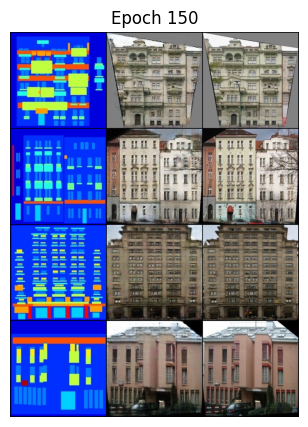

Saved sample to samples/epoch_150.png
Epoch 152


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.16563119173049926, G loss: 10.196443252563476, Recon loss: 0.0972443425655365


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.23984100350311824, G loss: 9.426089695521764, Recon loss: 0.09036329814365932
Epoch 153


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.1729492038488388, G loss: 10.164279327392578, Recon loss: 0.09668351531028747


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2378907778433391, G loss: 9.175101007734026, Recon loss: 0.08851376282317298
Epoch 154


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.1678560221195221, G loss: 10.015568199157714, Recon loss: 0.09528146117925644


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2536938786506653, G loss: 9.1763550894601, Recon loss: 0.08735084640128273
Epoch 155


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.18456120938062667, G loss: 10.018469467163087, Recon loss: 0.09523128926753997


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.26542150548526217, G loss: 9.243474960327148, Recon loss: 0.08891792808260236
Epoch 156


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.14651041984558105, G loss: 10.064416542053223, Recon loss: 0.09568710178136826


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.24270354211330414, G loss: 9.49657848903111, Recon loss: 0.09121302621705192
Epoch 157


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.1700078883767128, G loss: 10.103405303955078, Recon loss: 0.0960548985004425


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.236190099801336, G loss: 9.219154766627721, Recon loss: 0.08857083533491407
Epoch 158


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.17880251586437226, G loss: 10.127619819641113, Recon loss: 0.09603144884109498


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.25913280674389433, G loss: 9.300824982779366, Recon loss: 0.08867574696029935
Epoch 159


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.16635613441467284, G loss: 9.976081466674804, Recon loss: 0.09502680897712708


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.23822732056890214, G loss: 9.220102991376605, Recon loss: 0.08861031063965388
Epoch 160


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.18463796943426133, G loss: 10.026272888183593, Recon loss: 0.0954761278629303


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2436241784266063, G loss: 9.22682707650321, Recon loss: 0.08873926528862544
Epoch 161


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.17140530437231064, G loss: 9.863109703063964, Recon loss: 0.09348854720592499


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.24384857288428716, G loss: 8.93358325958252, Recon loss: 0.08593991718121938
GAN saved to folder: label2facade/checkpoints/checkpoint_epoch_160
Checkpoint saved to  label2facade/checkpoints/checkpoint_epoch_160


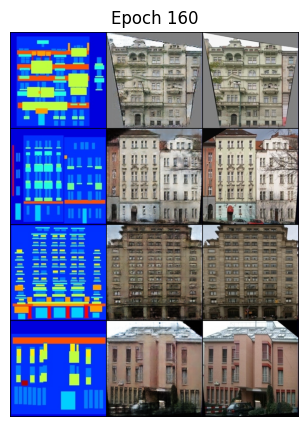

Saved sample to samples/epoch_160.png
Epoch 162


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.17510979861021042, G loss: 9.805244255065919, Recon loss: 0.09287325769662857


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.24396572368485586, G loss: 8.874942098345075, Recon loss: 0.08542757055589131
Epoch 163


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.20219579339027405, G loss: 9.821519813537599, Recon loss: 0.09322697192430496


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.3636161131518228, G loss: 8.607309341430664, Recon loss: 0.08482552000454494
Epoch 164


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.15107260912656784, G loss: 9.67693058013916, Recon loss: 0.09175989836454392


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2436435967683792, G loss: 8.825131825038365, Recon loss: 0.08461326573576246
Epoch 165


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.162483149766922, G loss: 9.755206756591797, Recon loss: 0.09251072436571121


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.23997863914285386, G loss: 8.815284184047155, Recon loss: 0.08476422727108002
Epoch 166


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.17528605014085769, G loss: 9.708417205810546, Recon loss: 0.09204479575157165


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2397046983242035, G loss: 8.644699505397252, Recon loss: 0.08331944048404694
Epoch 167


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.17678287833929063, G loss: 9.653824043273925, Recon loss: 0.09166982889175415


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2427463616643633, G loss: 8.764544078281947, Recon loss: 0.0838752378310476
Epoch 168


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.17976174801588057, G loss: 9.645379409790038, Recon loss: 0.09114703387022019


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.3036272781235831, G loss: 8.784238270350865, Recon loss: 0.08311381510325841
Epoch 169


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.17043050318956376, G loss: 9.376350708007813, Recon loss: 0.08861779510974883


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.23628370038100652, G loss: 8.444512707846505, Recon loss: 0.08111480197736196
Epoch 170


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.17940964549779892, G loss: 9.616078567504882, Recon loss: 0.09125715613365173


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.24108439683914185, G loss: 8.848184040614537, Recon loss: 0.0848817527294159
Epoch 171


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.14659177452325822, G loss: 9.604352493286132, Recon loss: 0.09131949543952941


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.24669990794999258, G loss: 8.93163790021624, Recon loss: 0.08553700894117355


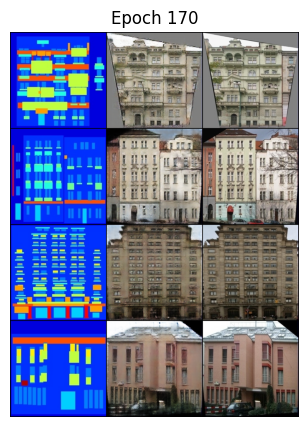

Saved sample to samples/epoch_170.png
Epoch 172


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.17260350912809372, G loss: 9.718007125854491, Recon loss: 0.09252805918455125


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.23828955846173422, G loss: 8.836683409554619, Recon loss: 0.08526059027229037
Epoch 173


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.18045901000499726, G loss: 9.705788230895996, Recon loss: 0.09212159246206283


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.24375575355121068, G loss: 8.598217827933174, Recon loss: 0.08200085163116455
Epoch 174


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.18355832636356353, G loss: 9.653452606201173, Recon loss: 0.09167693465948105


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.3008682131767273, G loss: 8.323394843510219, Recon loss: 0.08180100257907595
Epoch 175


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.152510946393013, G loss: 9.405784225463867, Recon loss: 0.08931634813547135


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.23532187512942723, G loss: 8.774047306605748, Recon loss: 0.0842507928609848
Epoch 176


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.18392698764801024, G loss: 9.527470092773438, Recon loss: 0.09050873667001724


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2634947342532022, G loss: 8.907510348728724, Recon loss: 0.08599810195820672
Epoch 177


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.17748252242803575, G loss: 9.429238471984863, Recon loss: 0.08937994360923768


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.23308469567980086, G loss: 8.814191273280553, Recon loss: 0.08481941372156143
Epoch 178


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.16838844239711762, G loss: 9.415358848571778, Recon loss: 0.08937751024961471


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.23182460452829087, G loss: 8.469563484191895, Recon loss: 0.08179306771074023
Epoch 179


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.18326873123645782, G loss: 9.427389144897461, Recon loss: 0.08926182568073272


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.2575992686407907, G loss: 8.542115075247628, Recon loss: 0.0810563223702567
Epoch 180


Training:   0%|          | 0/25 [00:00<?, ?it/s]

Training: D loss: 0.1599748933315277, G loss: 9.277255630493164, Recon loss: 0.0880916541814804


Validating:   0%|          | 0/7 [00:00<?, ?it/s]

Validation: D loss: 0.23356070263045176, G loss: 8.235412802015032, Recon loss: 0.07959886108125959


In [ ]:
train_history, val_history = trainer.train(train_loader, val_loader)

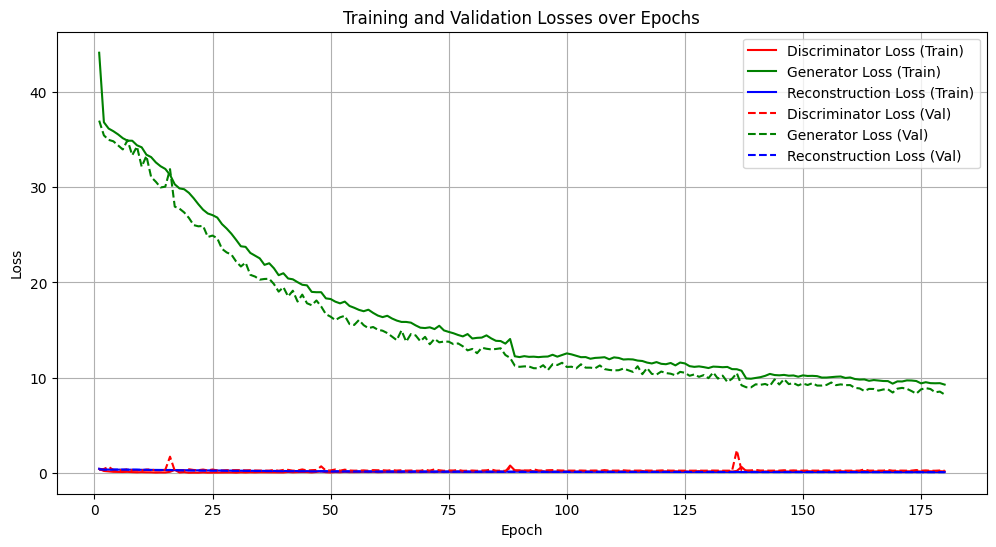

In [ ]:
import matplotlib.pyplot as plt

def plot_training_losses(train_history, val_history=None):
    epochs = range(1, len(train_history) + 1)

    d_train = [x['d_loss'] for x in train_history]
    g_train = [x['g_loss'] for x in train_history]
    recon_train = [x['recon_loss'] for x in train_history]

    plt.figure(figsize=(12, 6))

    plt.plot(epochs, d_train, label='Discriminator Loss (Train)', color='r')
    plt.plot(epochs, g_train, label='Generator Loss (Train)', color='g')
    plt.plot(epochs, recon_train, label='Reconstruction Loss (Train)', color='b')

    if val_history:
        d_val = [x['d_loss'] for x in val_history]
        g_val = [x['g_loss'] for x in val_history]
        recon_val = [x['recon_loss'] for x in val_history]

        plt.plot(epochs, d_val, label='Discriminator Loss (Val)', color='r', linestyle='--')
        plt.plot(epochs, g_val, label='Generator Loss (Val)', color='g', linestyle='--')
        plt.plot(epochs, recon_val, label='Reconstruction Loss (Val)', color='b', linestyle='--')

    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training and Validation Losses over Epochs')
    plt.legend()
    plt.grid(True)
    plt.show()

plot_training_losses(train_history, val_history)

In [ ]:
!pip install scikit-image


In [ ]:
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import peak_signal_noise_ratio as psnr
import numpy as np
import torch

def calculate_ssim_psnr(gen_images, target_images):
    gen_images_np = gen_images.detach().cpu().numpy().transpose(0, 2, 3, 1)
    target_images_np = target_images.detach().cpu().numpy().transpose(0, 2, 3, 1)

    ssim_values = []
    psnr_values = []

    for gen_img, tgt_img in zip(gen_images_np, target_images_np):
        gen_img = gen_img.astype(np.float64)
        tgt_img = tgt_img.astype(np.float64)

        ssim_val = ssim(tgt_img, gen_img, multichannel=True, data_range=1.0, channel_axis=2)
        psnr_val = psnr(tgt_img, gen_img, data_range=1.0)

        ssim_values.append(ssim_val)
        psnr_values.append(psnr_val)

    avg_ssim = np.mean(ssim_values)
    avg_psnr = np.mean(psnr_values)

    return avg_ssim, avg_psnr

def evaluate_ssim_psnr(gan, dataloader, device):
    gan.eval()
    ssim_scores = []
    psnr_scores = []

    with torch.no_grad():
        for source_images, target_images in tqdm(dataloader, desc="Evaluating"):
            source_images = source_images.to(device)
            target_images = target_images.to(device)

            generated_images = gan.generator(source_images)
            batch_ssim, batch_psnr = calculate_ssim_psnr(generated_images, target_images)

            ssim_scores.append(batch_ssim)
            psnr_scores.append(batch_psnr)

    avg_ssim = np.mean(ssim_scores)
    avg_psnr = np.mean(psnr_scores)

    print(f"Average SSIM: {avg_ssim:.4f}")
    print(f"Average PSNR: {avg_psnr:.2f}")

    return avg_ssim, avg_psnr

avg_ssim, avg_psnr = evaluate_ssim_psnr(gan, val_loader, device)

Evaluating:   0%|          | 0/7 [00:00<?, ?it/s]

Average SSIM: 0.6345
Average PSNR: 18.63


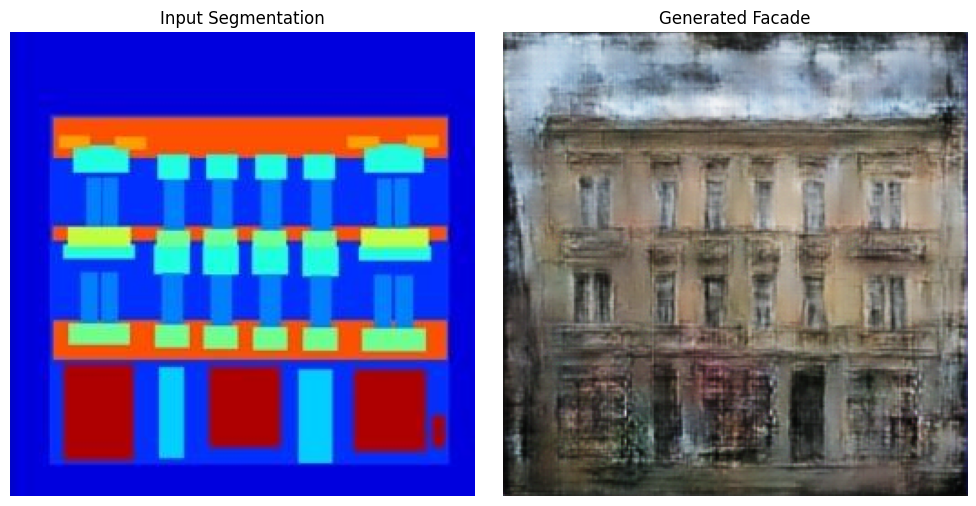

In [ ]:
import torch
from torchvision import transforms
from PIL import Image
import matplotlib.pyplot as plt

def load_image(image_path, image_size=(256, 256)):
    transform = transforms.Compose([
        transforms.Resize(image_size),
        transforms.ToTensor(),
        transforms.Normalize((0.5,), (0.5,))
    ])
    image = Image.open(image_path).convert('RGB')
    return transform(image).unsqueeze(0), image.resize(image_size)

def generate_and_display(model, segmentation_path, image_size=(256, 256), device='cpu'):
    model.eval()
    input_tensor, input_pil = load_image(segmentation_path, image_size)
    input_tensor = input_tensor.to(device)

    with torch.no_grad():
        output_tensor = model.generator(input_tensor).detach().cpu()

    output_tensor = (output_tensor + 1) / 2.0
    output_pil = transforms.ToPILImage()(output_tensor.squeeze(0))

    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].imshow(input_pil)
    axes[0].set_title("Input Segmentation")
    axes[0].axis('off')

    axes[1].imshow(output_pil)
    axes[1].set_title("Generated Facade")
    axes[1].axis('off')

    plt.tight_layout()
    plt.show()

segmentation_path = "/content/CMP_facade/testB/12.jpg"
generate_and_display(model=gan, segmentation_path=segmentation_path, device=device)
